## Refine epithelial cell annotations for large intestine - relabelling uncertain cells based on manual inspection/majority voting

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

In [2]:
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [3]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [4]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=12,
    frameon=False,
    transparent=True,
)

In [5]:
sns.set_style(style="white")
sns.set_context(context="paper")

### Import

In [6]:
#import data
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/disease/compartments/Epi.pooled_disease.gene_cellbender.good_qc_cluster_mito80.stringent_doublet_removed.hvg7500_noCC.scvi_output.lv20_batch256.with_raw_counts.20230124.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 56869 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [8]:
list(adata.obs.organ_unified.unique())

['ileum',
 'caecum',
 'rectum',
 'sigmoid colon',
 'colon',
 'ascending colon',
 'small intestine',
 'stomach']

In [9]:
#remove small and large intestine samples
adata = adata[adata.obs.organ_unified.isin(['stomach'])].copy()

In [10]:
adata

AnnData object with n_obs × n_vars = 29381 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [11]:
#import scanvi coordinates
adata_scanvi = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/X_scANVI/disease/disease_fine_annot_predict_Epi_stomach_method2_20230226.csv.gz',compression='gzip',index_col=0)

In [12]:
adata_scanvi

,LV1,LV2,LV3,LV4,LV5,LV6,LV7,LV8,LV9,LV10,LV11,LV12,LV13,LV14,LV15,LV16,LV17,LV18,LV19,LV20
index,,,,,,,,,,,,,,,,,,,,
AAACCTGGTTCCACGG-GSM5101014,-0.025055,0.889893,0.121449,0.987067,-2.541664,-0.058142,-0.044790,0.146847,0.055928,0.003618,0.014077,-0.031011,-0.718986,-0.424648,0.087391,0.419752,0.453669,-0.255607,0.130398,-0.735942
AAACCTGTCACGCGGT-GSM5101014,0.126843,0.940291,0.020037,-0.172433,-1.213913,-0.044740,-0.000993,0.042796,-0.032107,-0.033768,0.049372,0.016405,-0.708168,-0.317102,0.044843,-1.349654,0.746109,1.467191,0.065862,0.118387
AAACCTGTCCAATGGT-GSM5101014,0.388799,1.798071,0.048355,-0.940484,-1.757040,-0.088824,-0.030574,0.115651,-0.008967,-0.052639,0.028476,0.018434,-0.538627,-0.484586,0.118537,-0.872372,-0.062469,-0.131378,0.145966,-0.208324
AAACCTGTCCCTAACC-GSM5101014,1.044099,1.047772,0.021971,0.880272,-0.965975,-0.007191,-0.032586,0.107156,0.056604,-0.043163,0.080907,-0.083320,-0.086578,0.929621,0.054068,0.294104,-0.480644,-0.299769,-0.005435,0.739974
AAACGGGAGAGTACCG-GSM5101014,0.150430,0.606202,0.018474,0.913326,-0.338516,-0.057394,0.016461,0.016751,0.000782,-0.012406,0.039757,-0.039229,-0.357961,0.858247,0.002572,-0.419116,0.423387,1.106969,-0.058074,-0.506812
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCTCAGGATCT-GSM4546346,-2.328287,0.449437,0.016483,0.506281,-0.349298,-0.015936,-0.004751,-0.000363,0.046095,-0.052557,0.142270,-0.080415,0.541903,0.468405,0.032708,0.017921,-0.619122,0.277961,-0.167358,1.230665
TTTGGTTAGTGACTCT-GSM4546346,-1.767008,0.514987,-0.031408,1.002111,-0.768243,-0.003701,-0.039808,0.023162,0.028875,-0.106638,0.105413,-0.096340,-0.019220,0.441217,0.049059,-0.733963,-0.996164,-0.186415,-0.076054,2.112002
TTTGGTTCAAACTGTC-GSM4546346,2.049998,0.502613,0.005162,-0.370679,1.176120,0.135818,0.011708,-0.061063,0.036020,0.043064,0.038082,-0.097957,1.042476,-0.539892,0.026605,1.905586,0.110794,-0.013406,-0.114971,0.714059


In [13]:
adata.obsm['X_scANVI'] = adata_scanvi

In [14]:
#import metadata
adata_meta = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/disease/20230308/scanvi/disease_fine_annot_predict_Epi_stomach_method2_20230226.csv',index_col=0)

In [15]:
adata_meta

,latent_cell_probability,latent_RT_efficiency,cecilia22_predH,cecilia22_predH_prob,cecilia22_predH_uncertain,cecilia22_predL,cecilia22_predL_prob,cecilia22_predL_uncertain,elmentaite21_pred,elmentaite21_pred_prob,...,martin19_pred_uncertain,warner20_pred,warner20_pred_prob,warner20_pred_uncertain,broad_predicted_labels,broad_predicted_labels_uncert,fine_annot,fine_predicted_labels,fine_predicted_labels_uncertainty,scanvi_pred
index,,,,,,,,,,,,,,,,,,,,,
AAACCTGGTTCCACGG-GSM5101014,0.999850,1.026135,T cells,0.064910,Uncertain,Tcm/Naive helper T cells,0.080985,Uncertain,TA,0.730483,...,EC progenitor,DC2,0.102897,Uncertain,Epithelial,0.000000e+00,Unknown,Doublets,4.800055e-01,Gastric_fetal_epithelial
AAACCTGTCACGCGGT-GSM5101014,0.999951,1.635007,Epithelial cells,0.992968,Epithelial cells,Epithelial cells,0.997998,Epithelial cells,Microfold cell,0.991395,...,EC progenitor,Basal,0.144218,Uncertain,Epithelial,0.000000e+00,Unknown,MUC6,4.399918e-01,Goblet_progenitor
AAACCTGTCCAATGGT-GSM5101014,0.999979,1.445156,Epithelial cells,0.997977,Epithelial cells,Epithelial cells,0.998869,Epithelial cells,Microfold cell,0.986246,...,EC progenitor,Ionocytes,0.136004,Uncertain,Epithelial,0.000000e+00,Unknown,MUC6,2.999560e-01,Goblet_progenitor
AAACCTGTCCCTAACC-GSM5101014,0.999971,1.577106,Epithelial cells,0.602373,Epithelial cells,Epithelial cells,0.560122,Epithelial cells,Microfold cell,0.808846,...,EC progenitor,Mucous Acini,0.527577,Mucous Acini,Epithelial,0.000000e+00,Unknown,MUC5AC,5.599276e-01,MUC5AC
AAACGGGAGAGTACCG-GSM5101014,0.998578,0.727382,T cells,0.821998,T cells,Tcm/Naive helper T cells,0.055553,Uncertain,TA,0.544598,...,EC progenitor,Th,0.114730,Uncertain,Epithelial,0.000000e+00,Unknown,MUC6,5.600007e-01,Doublets
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCGCTCAGGATCT-GSM4546346,0.999774,1.340966,Plasma cells,0.896203,Plasma cells,Epithelial cells,0.578191,Epithelial cells,Microfold cell,0.294809,...,Epi MUC6+,Mucous Acini,0.473997,Mucous Acini,Epithelial,0.000000e+00,Unknown,MUC6,0.000000e+00,MUC6
TTTGGTTAGTGACTCT-GSM4546346,0.999709,1.162290,Plasma cells,0.162929,Uncertain,Plasma cells,0.016857,Uncertain,Microfold cell,0.988686,...,Epi MUC6+,Mucous Acini,0.526120,Mucous Acini,Epithelial,5.960464e-08,Unknown,MUC6,5.960464e-08,MUC6
TTTGGTTCAAACTGTC-GSM4546346,0.999884,1.969957,Epithelial cells,0.001299,Uncertain,Epithelial cells,0.000933,Uncertain,Microfold cell,0.934889,...,Epi MUC6+,VE ven,0.134451,Uncertain,Epithelial,5.960464e-08,Unknown,Cycling,4.999707e-01,MUC5AC


In [16]:
adata.obs = adata_meta

### Process

In [17]:
#compute neighbours and umap
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


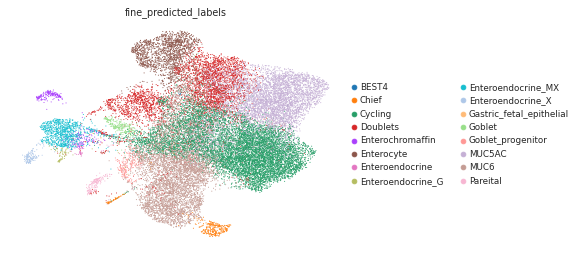

In [18]:
sc.pl.umap(adata, color=['fine_predicted_labels'])

In [19]:
adata.obs.donor_disease.unique()

['cancer']
Categories (1, object): ['cancer']

In [20]:
#fix metadata
adata.obs['disease'] = adata.obs['donor_category'].astype(str) + '_' + adata.obs['donor_disease'].astype(str)

In [21]:
list(adata.obs.disease.unique())

['disease_cancer']

In [22]:
adata.obs['donor_disease'] = (adata.obs['disease'].map(lambda x:{
 'disease_cancer':'cancer_gastric',
    'control_control':'control',
 'control_CD':'CD',
 'disease_PIBD':'PIBD',
 'disease_cancer':'cancer_colorectal',
 'disease_CD':'CD',
'disease_UC':'UC'
    
    }.get(x,x)).astype("category"))

In [23]:
adata.obs.donor_disease.unique()

['cancer_gastric']
Categories (1, object): ['cancer_gastric']

In [24]:
adata.obs['disease'] = (adata.obs['disease'].map(lambda x:{
'disease_cancer':'cancer_gastric',
    }.get(x,x)).astype("category"))

In [25]:
list(adata.obs.disease.unique())

['cancer_gastric']

In [26]:
adata.obs.fine_predicted_labels.cat.categories

Index(['BEST4', 'Chief', 'Cycling', 'Doublets', 'Enterochromaffin',
       'Enterocyte', 'Enteroendocrine', 'Enteroendocrine_G',
       'Enteroendocrine_MX', 'Enteroendocrine_X', 'Gastric_fetal_epithelial',
       'Goblet', 'Goblet_progenitor', 'MUC5AC', 'MUC6', 'Pareital'],
      dtype='object')

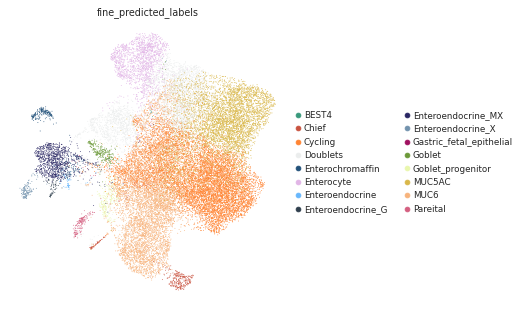

In [27]:
#plot umaps
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels',palette = ['#39997c',#BEST4
                                            '#c95340',#chief
                                            '#ff8433',#'Cycling'
                                            '#ebeded',#doublets
                                           '#22517a',#enterochromaffin
                                            '#e1b5e6',#enterocyte
                                           '#68b7fc',#enteroendocrine
                                            '#2f3f4d',#G_enteroendocrine
                                            '#292663',#MX enteroendocrine
                                            '#7292ad',#X_enteroendocrine
                                            '#a01160',#gastric fetal epithelium
                                            '#6c9939',#goblet
                                            '#e9f7ad',#goblet progenitor
                                            '#d9b74a',#MUC5AC
                                            '#f7b37c',#MUC6
                                           '#d45f80',#pareital 
                                                         ],size=3)

In [28]:
adata.obs['disease'].cat.categories

Index(['cancer_gastric'], dtype='object')

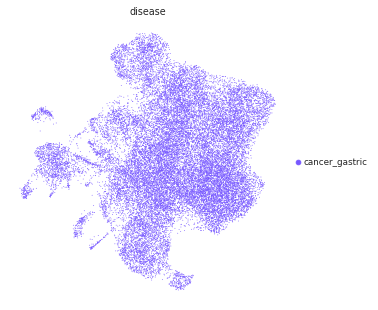

In [29]:
sc.pl.umap(adata,color = 'disease',palette=[
                                            '#7657ff',#gastric cancer
                                           ],size=3)

In [30]:
adata.layers['counts'] = adata.X

In [31]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [34]:
marker_genes_dict = { 'BEST4':['BEST4','SPIB','CA7','GUCA2B','CFTR'],
                      'Chief':['PGA5','LIPF','PGA3','PGC','CHIA'],
                     'Cycling':['MKI67','PCLAF','PCNA'],
                     'Enterochromaffin':['HDC','MAOB','LHX5-AS1','KLK11','CHGA'],
                     
                     
                     'Enterocyte':['FABP1','ENPEP','APOA4','PRAP1'], 
                        'Enteroendocrine':['SST','GHRL','GC','ACSL1','S100A1'],
                     'G_enteroendocrine':['GAST','SCGB2A1','CLTRN','CES1','PAX6'],
                     'MX_enteroendocrine':['HOPX','CRYBA2','GCG','MLN','GLS'],
                     'X_enteroendocrine':['GHRL'],
                     'Fetal':['DDIT4','ALDOA','VIM','CCN1'],
                     
                     
                     'Goblet':['MUC2','TFF3','SPINK4','FCGBP'],
                     'Goblet_progenitor':['ODAM','CLDN2','OLFM4'],
                        'Surface Foveolar':['MUC5AC','GKN1','GKN2'],
                     'Mucous Gland Neck':['MUC6','AQP5','BPIFB1'],
   
                     'Pareital':['ATP4A','ATP4B','CBLIF','GPR155','MFSD4A']
                    
                       
                     
                     
                     
                     
}

In [35]:
adata

AnnData object with n_obs × n_vars = 29381 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


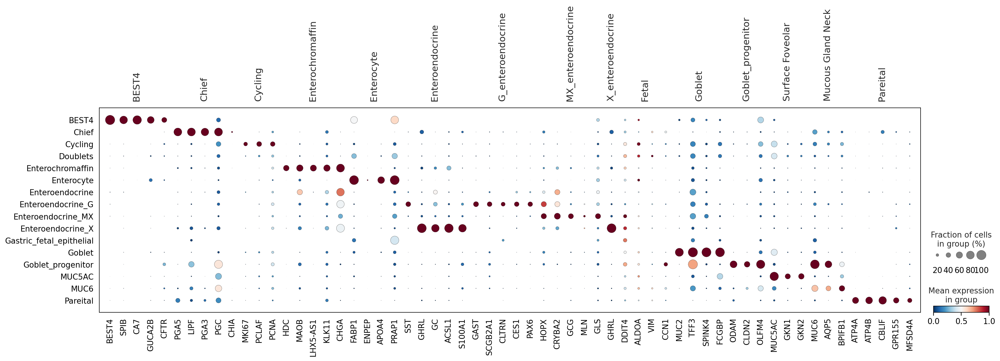

In [36]:
#plot markers
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_predicted_labels',save='Epi_stomach_markers.png',color_map='RdBu_r', standard_scale='var')

### Define uncertain cells

In [37]:
uncert = adata.obs[['fine_predicted_labels','fine_predicted_labels_uncertainty']] 

In [38]:
#calculate 90th percentile to use as cut off for uncertain cells
p = np.percentile(adata.obs['fine_predicted_labels_uncertainty'], 90) # return 90th percentile
print(p)

0.480283260345459


(array([9.796e+03, 1.638e+03, 1.229e+03, 1.992e+03, 7.960e+02, 7.330e+02,
        1.431e+03, 6.160e+02, 6.190e+02, 9.410e+02, 8.430e+02, 5.640e+02,
        5.880e+02, 1.127e+03, 5.670e+02, 5.350e+02, 1.243e+03, 6.060e+02,
        5.880e+02, 8.020e+02, 6.230e+02, 3.560e+02, 2.680e+02, 4.490e+02,
        1.710e+02, 1.000e+02, 1.120e+02, 3.200e+01, 1.200e+01, 4.000e+00]),
 array([0.        , 0.02599945, 0.0519989 , 0.07799835, 0.1039978 ,
        0.12999725, 0.1559967 , 0.18199615, 0.2079956 , 0.23399505,
        0.2599945 , 0.28599395, 0.3119934 , 0.33799285, 0.3639923 ,
        0.38999175, 0.4159912 , 0.44199064, 0.46799009, 0.49398954,
        0.51998899, 0.54598844, 0.57198789, 0.59798734, 0.62398679,
        0.64998624, 0.67598569, 0.70198514, 0.72798459, 0.75398404,
        0.77998349]),
 <BarContainer object of 30 artists>)

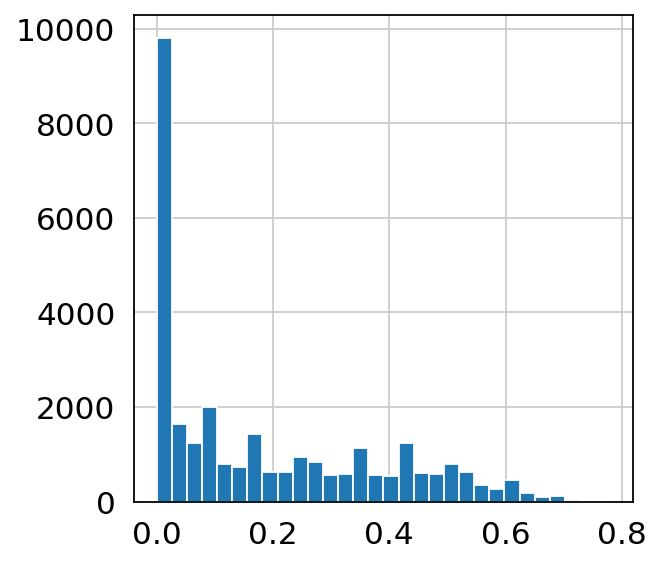

In [39]:
#plot uncertainty distribution
plt.hist(adata.obs['fine_predicted_labels_uncertainty'], bins=30)

In [40]:
uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')

<ipython-input-40-905f2ed234d6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')


In [41]:
adata.obs['disease'].unique()

['cancer_gastric']
Categories (1, object): ['cancer_gastric']

In [42]:
#mark cells are unknown based on cut off of 90th percentile
uncert.loc[uncert["fine_predicted_labels_uncertainty"] > p, "fine_predicted_labels"] = "Unknown"

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [43]:
adata.obs['fine_predicted_labels_uncertflagged'] = adata.obs['fine_predicted_labels']

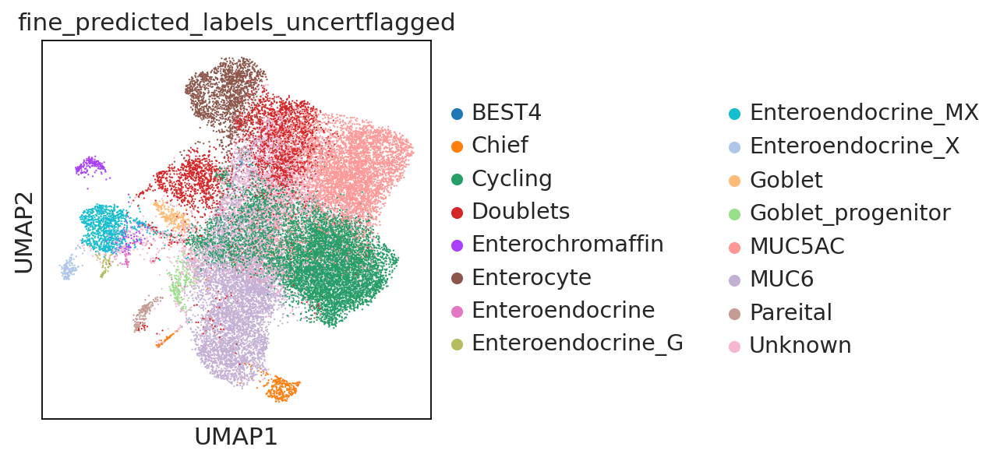

In [44]:
ON = {O:N for O,N in zip(uncert.index,uncert["fine_predicted_labels"])}
adata.obs["fine_predicted_labels_uncertflagged"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged')

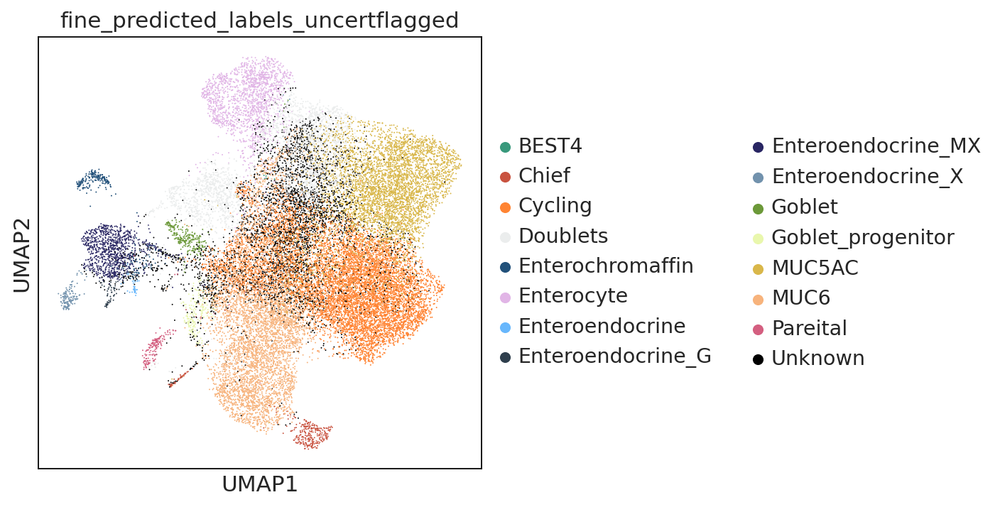

In [45]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',palette = ['#39997c',#BEST4
                                            '#c95340',#chief
                                            '#ff8433',#'Cycling'
                                            '#ebeded',#doublets
                                           '#22517a',#enterochromaffin
                                            '#e1b5e6',#enterocyte
                                           '#68b7fc',#enteroendocrine
                                            '#2f3f4d',#G_enteroendocrine
                                            '#292663',#MX enteroendocrine
                                            '#7292ad',#X_enteroendocrine
                                            '#6c9939',#goblet
                                            '#e9f7ad',#goblet progenitor
                                            '#d9b74a',#MUC5AC
                                            '#f7b37c',#MUC6
                                           '#d45f80',#pareital 
                                                          '#000000',#unknown
                                               
                                               
    
    
                                              ],size=3)

### Finalise annotations
- calculate leiden clusters
- inspect annotations across leiden clusters
- assess marker genes, doublet markers, donor distribution
- relabel based on majority voting of leiden clusters, along with confirmation from marker genes etc.

In [46]:
#reassign labels for unknown cells by leiden clustering and majority voting
sc.tl.leiden(adata,resolution=1,key_added='leiden1')

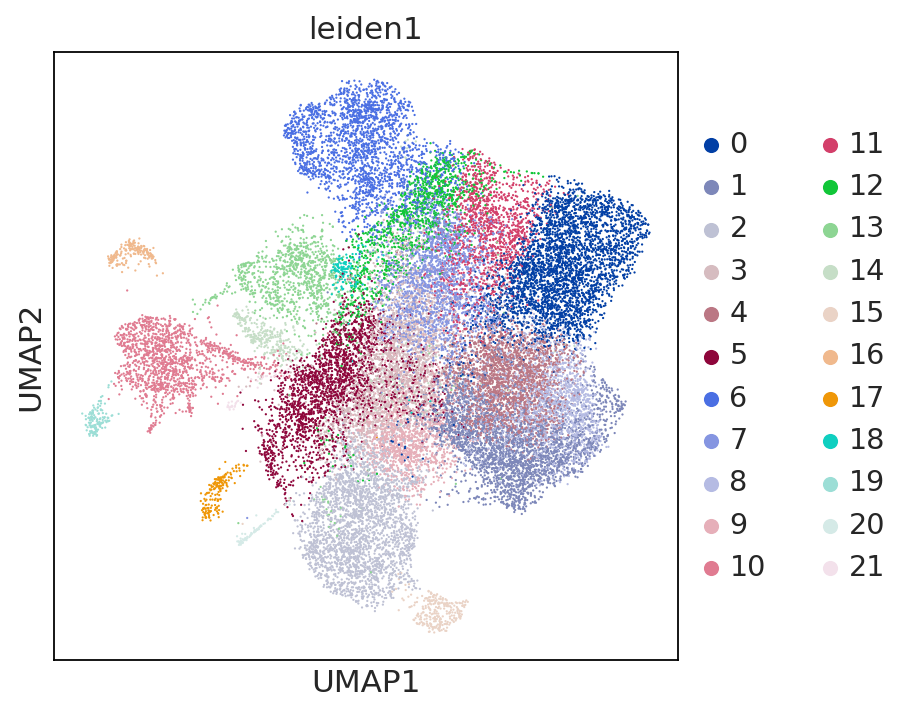

In [47]:
sc.pl.umap(adata,color='leiden1')

In [48]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Chief,Cycling,Doublets,Enterochromaffin,Enterocyte,Enteroendocrine,Enteroendocrine_G,Enteroendocrine_MX,Enteroendocrine_X,Goblet,Goblet_progenitor,MUC5AC,MUC6,Pareital,Unknown
leiden1,,,,,,,,,,,,,,,,
0,0,0,15,4,0,0,0,0,0,0,0,0,3257,59,0,78
1,0,0,2462,22,0,0,0,0,0,0,0,0,89,22,0,151
2,0,12,0,18,0,1,0,0,0,0,0,0,11,2526,0,31
3,0,8,715,203,0,13,0,0,1,0,0,0,255,529,14,762
4,0,0,2220,15,0,0,0,0,0,0,0,0,0,0,0,44
5,0,0,742,9,0,22,0,2,4,0,0,197,0,768,0,482
6,0,0,8,481,0,1614,0,0,0,3,0,0,1,0,0,81
7,0,0,474,507,0,20,0,0,0,0,0,0,248,80,0,686
8,0,0,1288,9,0,0,0,0,0,0,0,0,158,14,0,153


In [49]:
#Use Leiden resolution 1
unknown = adata.obs[['leiden1','fine_predicted_labels_uncertflagged']]

In [50]:
unknown = unknown[unknown['fine_predicted_labels_uncertflagged'].isin(['Unknown'])]

In [51]:
unknown

,leiden1,fine_predicted_labels_uncertflagged
index,,
AAACCTGGTTCCACGG-GSM5101014,3,Unknown
AAACCTGTCCCTAACC-GSM5101014,9,Unknown
AAACGGGAGAGTACCG-GSM5101014,13,Unknown
AAAGATGGTTCAGTAC-GSM5101014,12,Unknown
AAAGCAAGTTATGCGT-GSM5101014,11,Unknown
...,...,...
TGCACCTTCTGTCCGT-GSM4546346,8,Unknown
TGCCCTATCGTAGATC-GSM4546346,1,Unknown
TGCGGGTCAACACCCG-GSM4546346,12,Unknown


/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


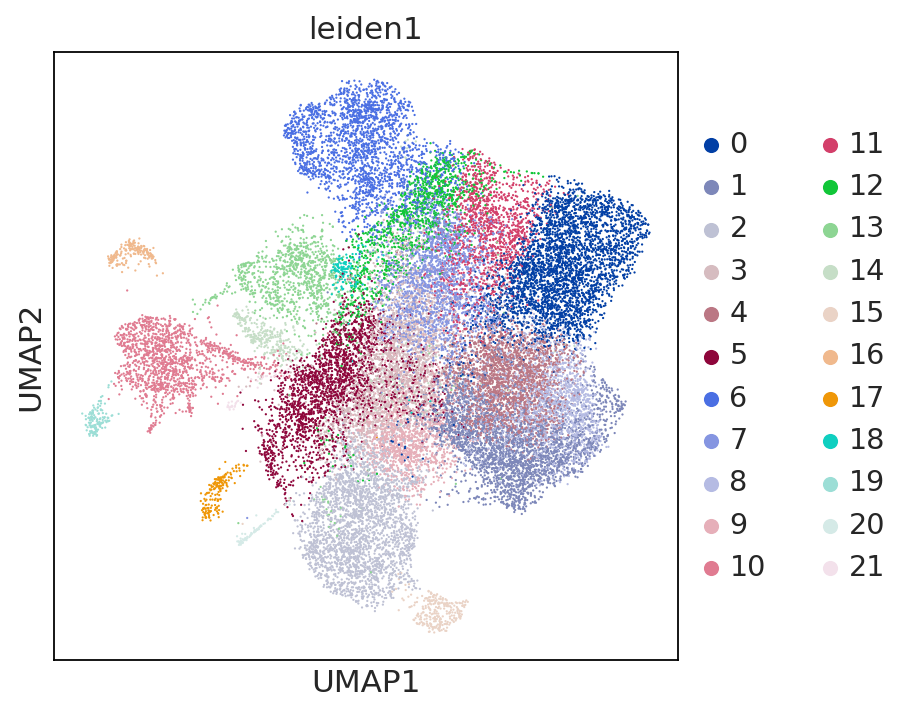

In [52]:
sc.pl.umap(adata,color='leiden1')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


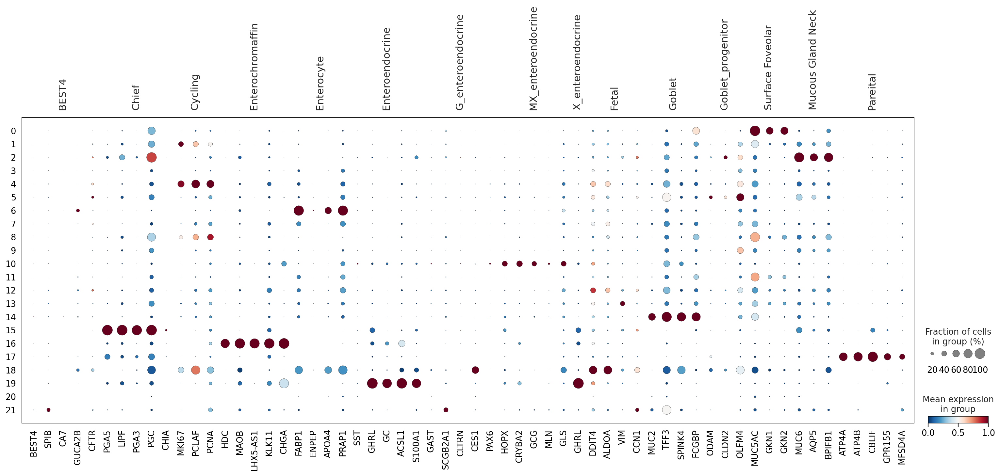

In [53]:
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var')

In [54]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Chief,Cycling,Doublets,Enterochromaffin,Enterocyte,Enteroendocrine,Enteroendocrine_G,Enteroendocrine_MX,Enteroendocrine_X,Goblet,Goblet_progenitor,MUC5AC,MUC6,Pareital,Unknown
leiden1,,,,,,,,,,,,,,,,
0,0,0,15,4,0,0,0,0,0,0,0,0,3257,59,0,78
1,0,0,2462,22,0,0,0,0,0,0,0,0,89,22,0,151
2,0,12,0,18,0,1,0,0,0,0,0,0,11,2526,0,31
3,0,8,715,203,0,13,0,0,1,0,0,0,255,529,14,762
4,0,0,2220,15,0,0,0,0,0,0,0,0,0,0,0,44
5,0,0,742,9,0,22,0,2,4,0,0,197,0,768,0,482
6,0,0,8,481,0,1614,0,0,0,3,0,0,1,0,0,81
7,0,0,474,507,0,20,0,0,0,0,0,0,248,80,0,686
8,0,0,1288,9,0,0,0,0,0,0,0,0,158,14,0,153


In [55]:
unknown_adata = adata[adata.obs['fine_predicted_labels_uncertflagged'].isin(['Unknown'])].copy()

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


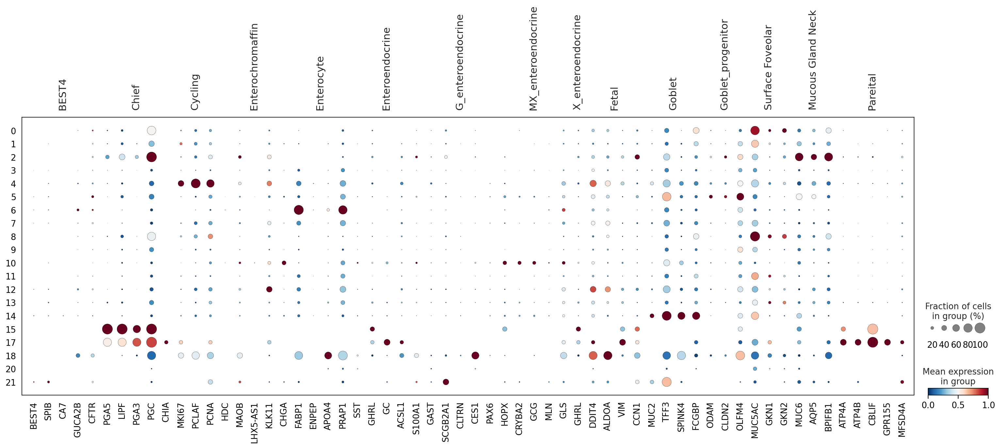

In [56]:
sc.pl.dotplot(unknown_adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var')

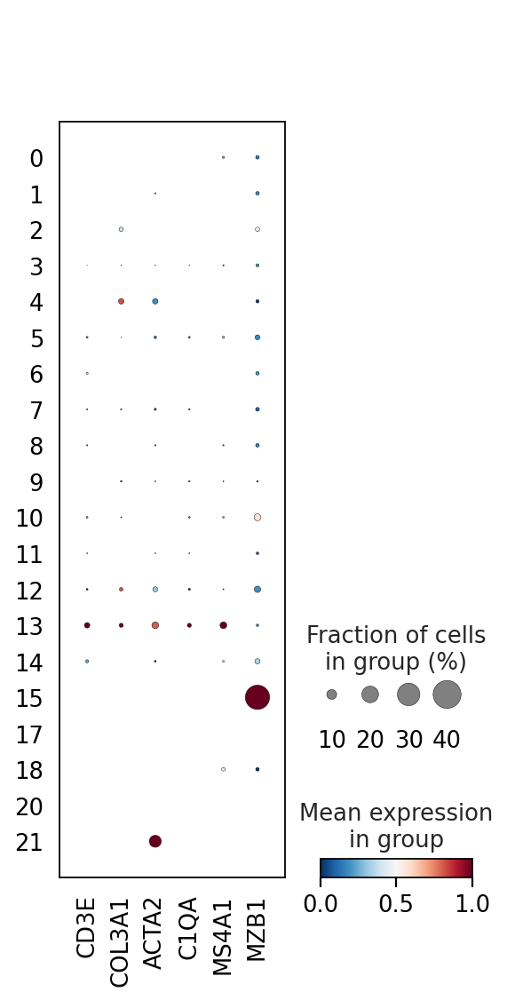

In [57]:
#plot some doublet markers
sc.pl.dotplot(unknown_adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

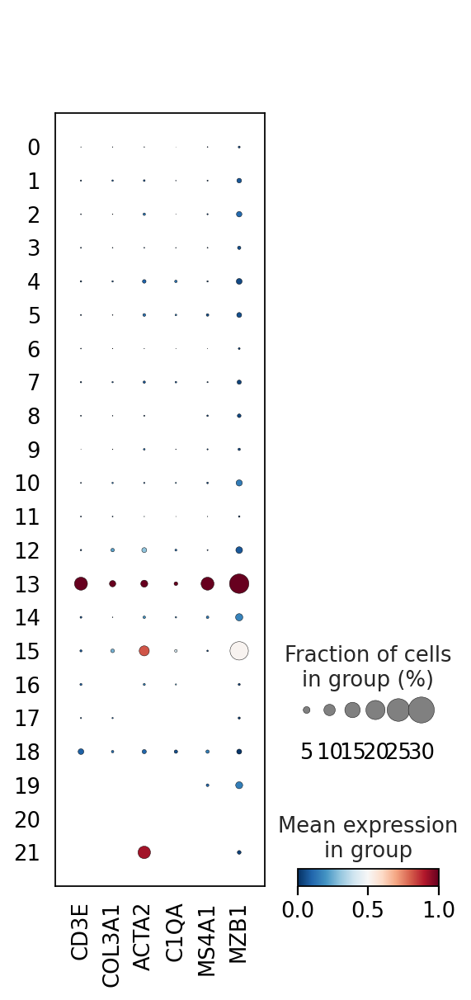

In [58]:
#plot some doublet markers
sc.pl.dotplot(adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


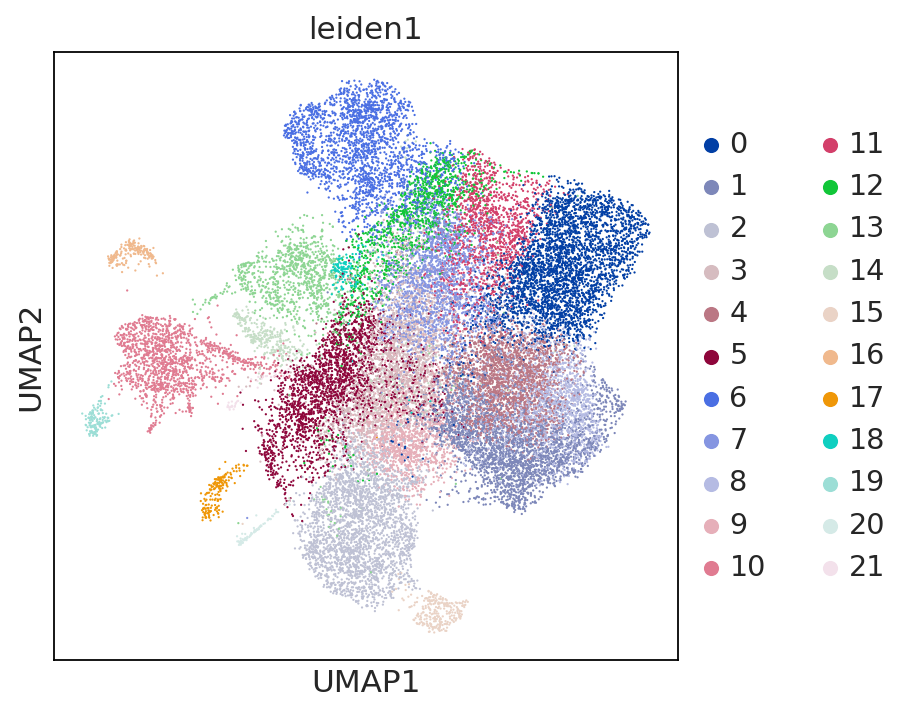

In [59]:
sc.pl.umap(adata,color='leiden1')

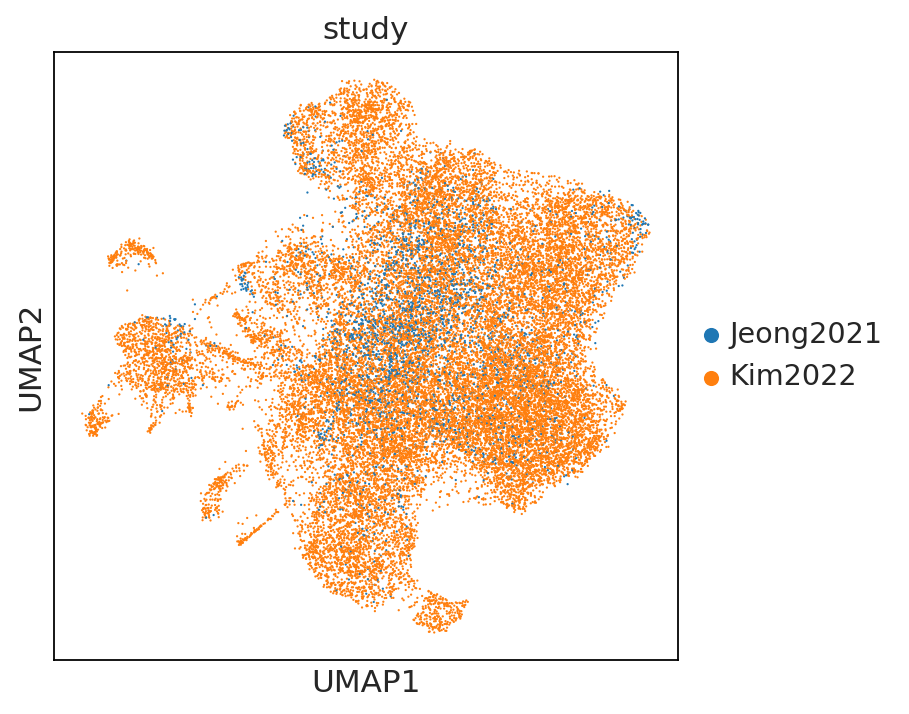

In [95]:
sc.pl.umap(adata,color='study')

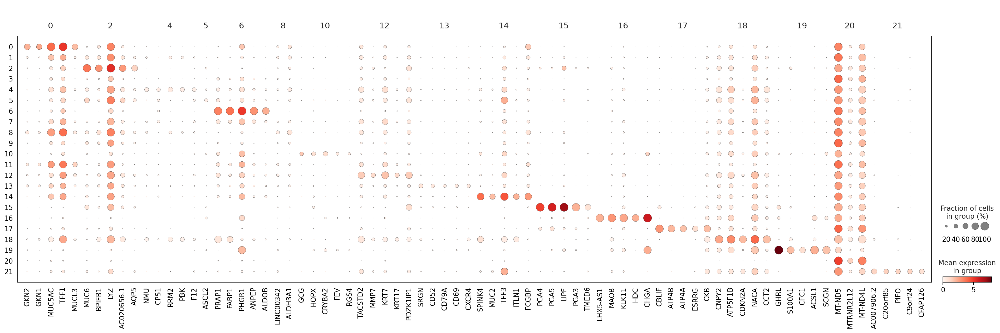

In [60]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden1")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden1', mks=mks)

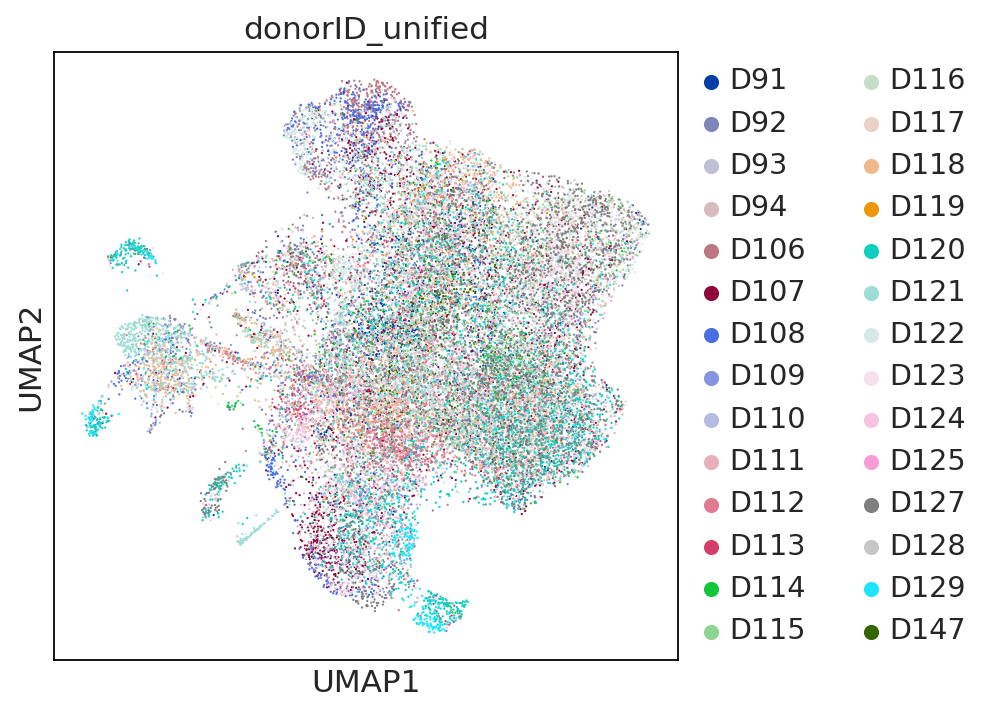

In [61]:
sc.pl.umap(adata,color='donorID_unified')

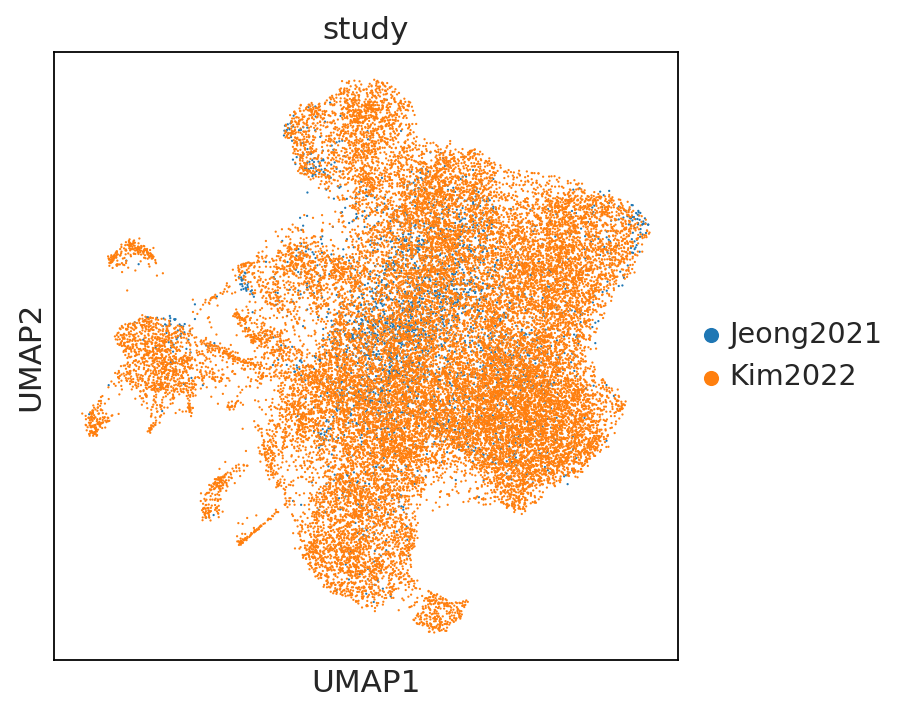

In [62]:
sc.pl.umap(adata,color='study')

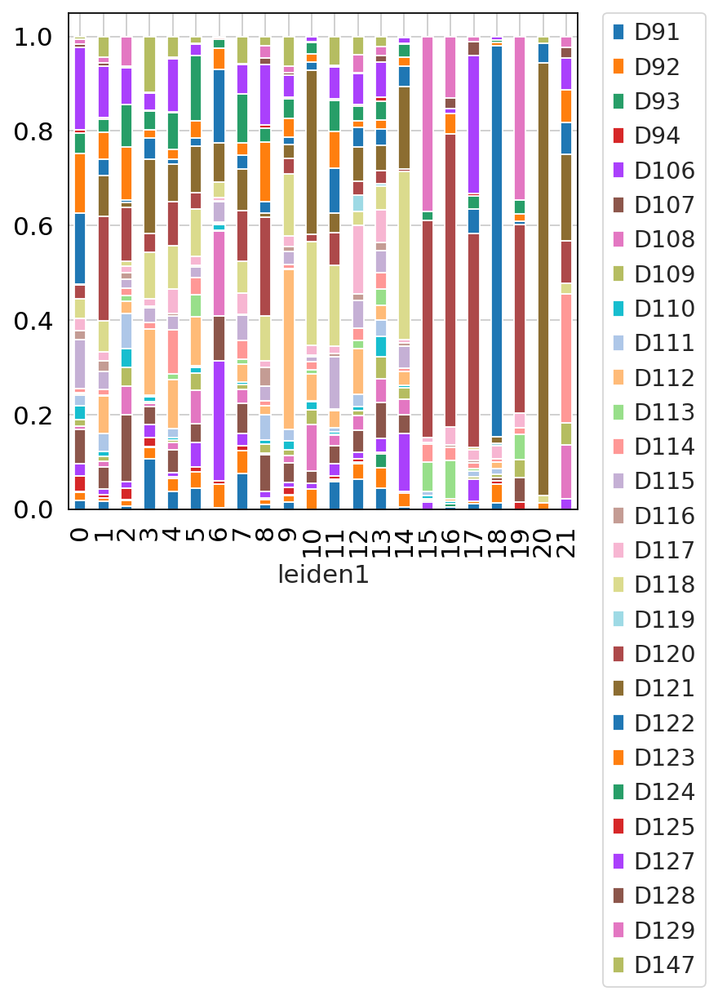

In [63]:
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

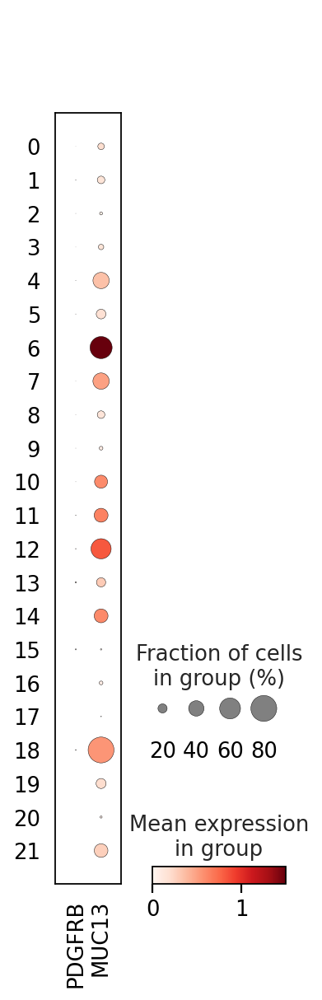

In [64]:
sc.pl.dotplot(adata,var_names = ['PDGFRB','MUC13'],groupby='leiden1')

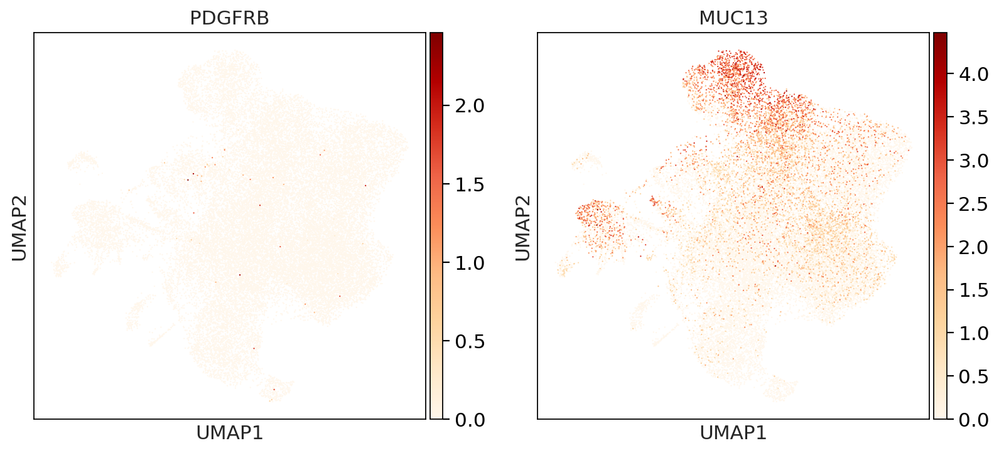

In [65]:
sc.pl.umap(adata,color=['PDGFRB','MUC13'],cmap='OrRd')

In [66]:
#score cell cycle genes
cell_cycle_genes = ['MCM5',
'PCNA',
 'TYMS',
 'FEN1',
 'MCM2',
 'MCM4',
 'RRM1',
 'UNG',
 'GINS2',
 'MCM6',
 'CDCA7',
 'DTL',
 'PRIM1',
 'UHRF1',
 'MLF1IP',
 'HELLS',
 'RFC2',
 'RPA2',
 'NASP',
 'RAD51AP1',
 'GMNN',
 'WDR76',
 'SLBP',
 'CCNE2',
 'UBR7',
 'POLD3',
 'MSH2',
 'ATAD2',
 'RAD51',
 'RRM2',
 'CDC45',
 'CDC6',
 'EXO1',
 'TIPIN',
 'DSCC1',
 'BLM',
 'CASP8AP2',
 'USP1',
 'CLSPN',
 'POLA1',
 'CHAF1B',
 'BRIP1',
 'E2F8',
 'HMGB2',
 'CDK1',
 'NUSAP1',
 'UBE2C',
 'BIRC5',
 'TPX2',
 'TOP2A',
 'NDC80',
 'CKS2',
 'NUF2',
 'CKS1B',
 'MKI67',
 'TMPO',
 'CENPF',
 'TACC3',
 'FAM64A',
 'SMC4',
 'CCNB2',
 'CKAP2L',
 'CKAP2',
 'AURKB',
 'BUB1',
 'KIF11',
 'ANP32E',
 'TUBB4B',
 'GTSE1',
 'KIF20B',
 'HJURP',
 'CDCA3',
 'HN1',
 'CDC20',
 'TTK',
 'CDC25C',
 'KIF2C',
 'RANGAP1',
 'NCAPD2',
 'DLGAP5',
 'CDCA2',
 'CDCA8',
 'ECT2',
 'KIF23',
 'HMMR',
 'AURKA',
 'PSRC1',
 'ANLN',
 'LBR',
 'CKAP5',
 'CENPE',
 'CTCF',
 'NEK2',
 'G2E3',
 'GAS2L3',
 'CBX5',
 'CENPA']

In [67]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata = adata[adata.obs.G2M_score.sort_values(ascending=True).index].copy()

In [68]:
adata

AnnData object with n_obs × n_vars = 29381 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

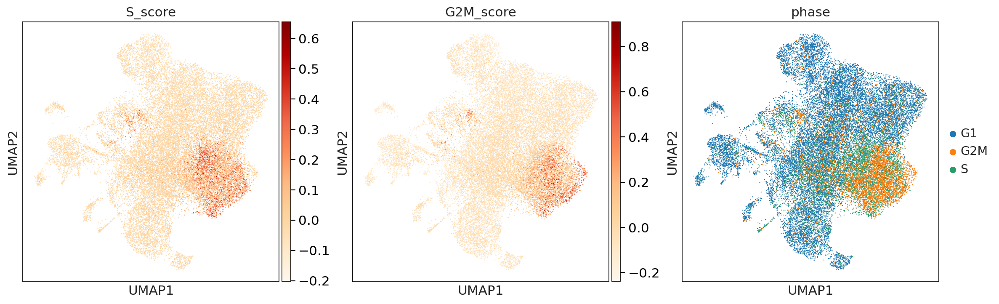

In [69]:
sc.pl.umap(adata,color=['S_score','G2M_score','phase'],cmap='OrRd')

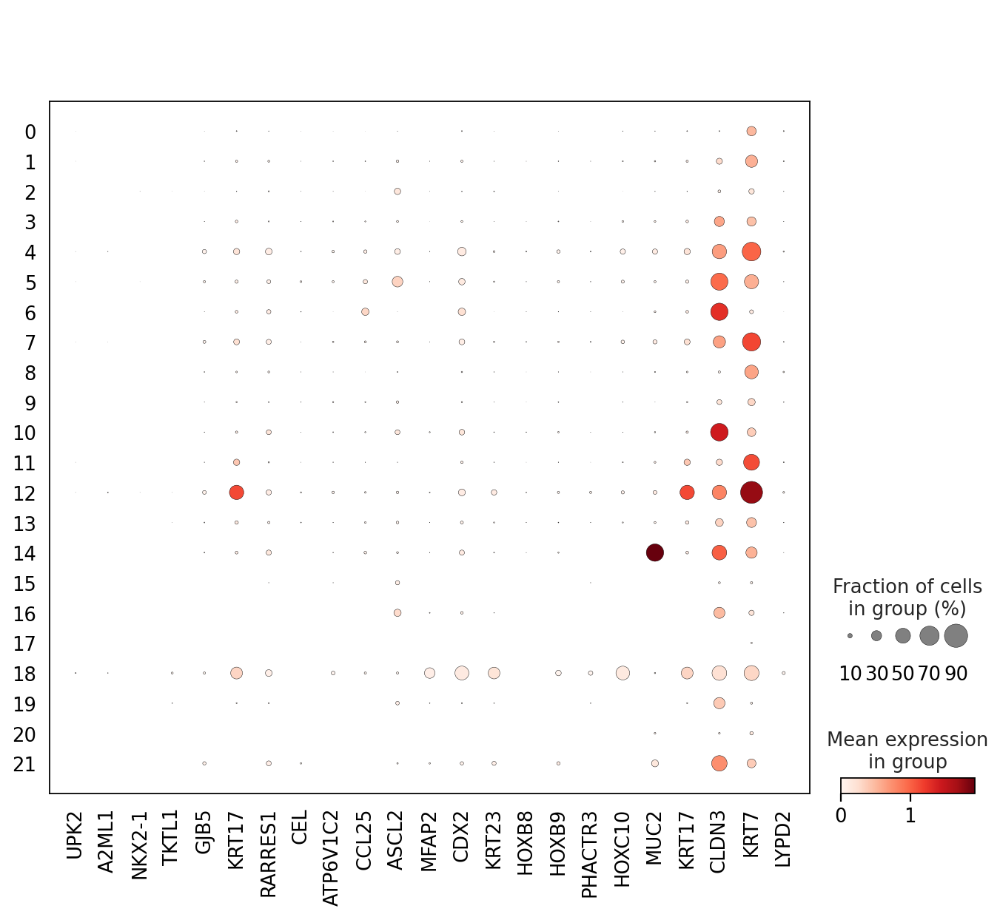

In [70]:
#https://www.nature.com/articles/s41467-022-32627-z/figures/2
#plot some cancer markers from this study
sc.pl.dotplot(adata,var_names = ['UPK2','A2ML1','NKX2-1','TKTL1','GJB5','KRT17','RARRES1',
                                 'CEL','ATP6V1C2','CCL25','ASCL2','MFAP2','CDX2','KRT23','HOXB8','HOXB9','PHACTR3',
                                 'HOXC10','MUC2','KRT17','CLDN3','KRT7','LYPD2'],groupby='leiden1')

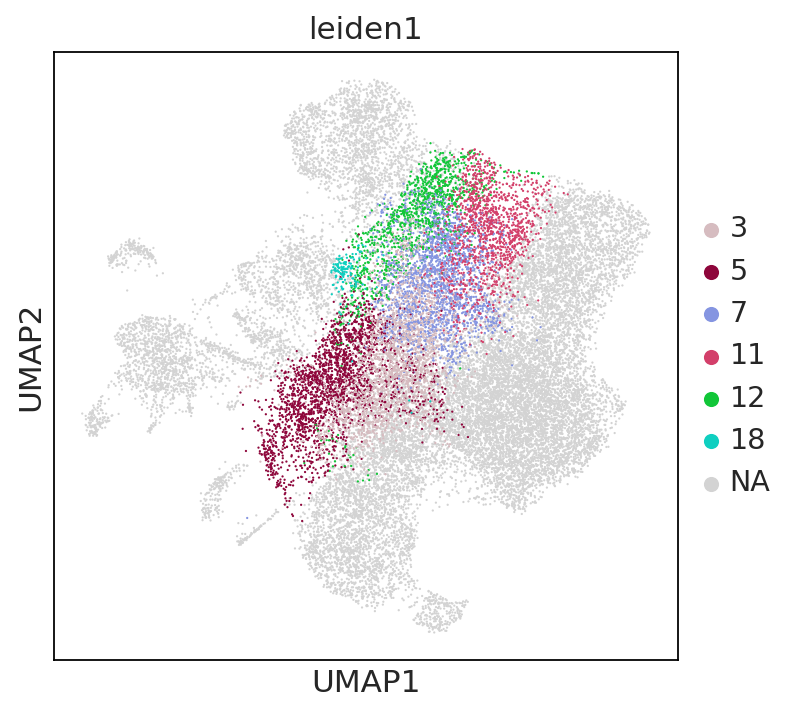

In [71]:
sc.pl.umap(adata,color='leiden1',groups=['3','5','7','11','12','18'])

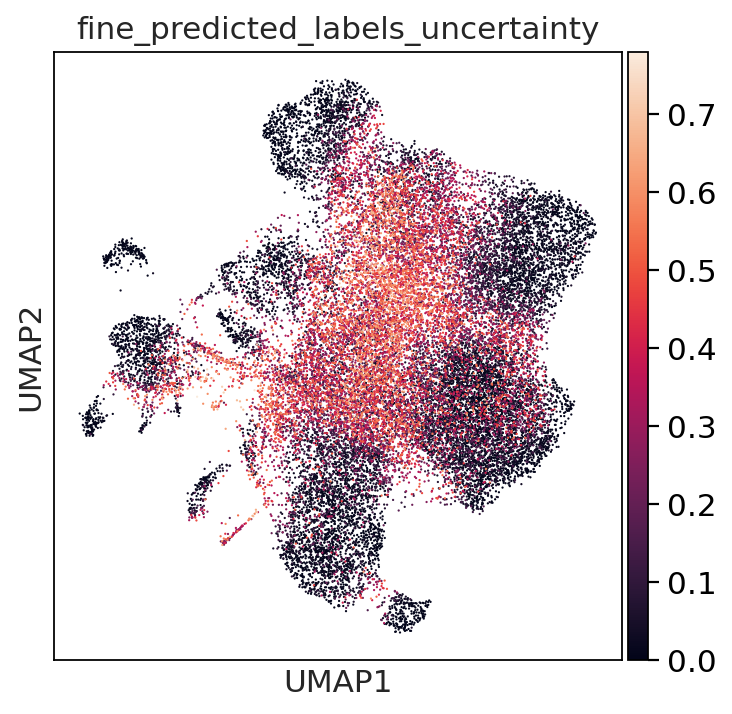

In [72]:
sc.pl.umap(adata,color='fine_predicted_labels_uncertainty')

In [73]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Chief,Cycling,Doublets,Enterochromaffin,Enterocyte,Enteroendocrine,Enteroendocrine_G,Enteroendocrine_MX,Enteroendocrine_X,Goblet,Goblet_progenitor,MUC5AC,MUC6,Pareital,Unknown
leiden1,,,,,,,,,,,,,,,,
0,0,0,15,4,0,0,0,0,0,0,0,0,3257,59,0,78
1,0,0,2462,22,0,0,0,0,0,0,0,0,89,22,0,151
2,0,12,0,18,0,1,0,0,0,0,0,0,11,2526,0,31
3,0,8,715,203,0,13,0,0,1,0,0,0,255,529,14,762
4,0,0,2220,15,0,0,0,0,0,0,0,0,0,0,0,44
5,0,0,742,9,0,22,0,2,4,0,0,197,0,768,0,482
6,0,0,8,481,0,1614,0,0,0,3,0,0,1,0,0,81
7,0,0,474,507,0,20,0,0,0,0,0,0,248,80,0,686
8,0,0,1288,9,0,0,0,0,0,0,0,0,158,14,0,153


In [74]:
#quick look at leiden resolution 0.5
sc.tl.leiden(adata,resolution=0.5,key_added='leiden0.5')

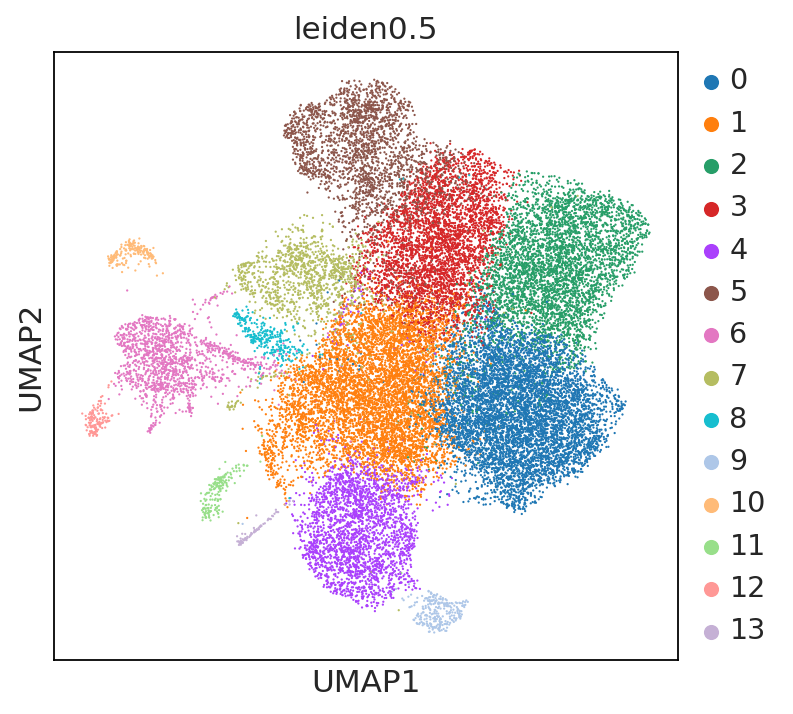

In [75]:
sc.pl.umap(adata,color='leiden0.5')

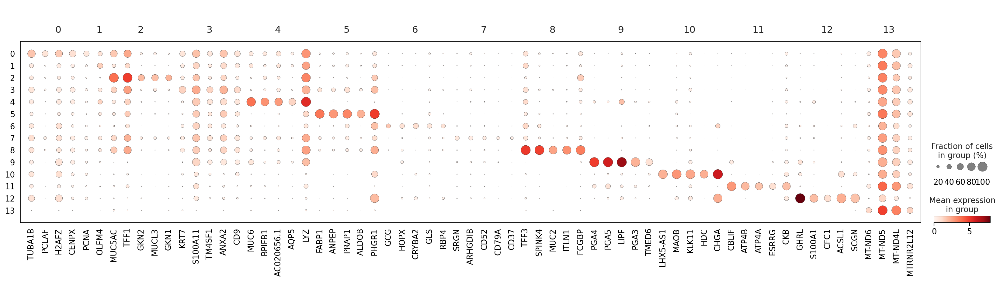

In [76]:
mkst = calc_marker_stats(adata, groupby="leiden0.5")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden0.5', mks=mks)

In [80]:
unknown['fine_predicted_labels_resolved'] = (unknown['leiden1']
        .map(lambda x:{'0':'MUC5AC',
                       '1':'Cycling',
                       '2':'MUC6',
                       '3':'Tumour cells?', #mixture of many
                       '4':'Cycling',
                       '5':'Tumour cells?', 
                       '6':'Enterocyte',
                       '7':'Tumour cells?',
                       '8':'Cycling', 
                       '9':'MUC6',
                       '10':'Enteroendocrine_MX',
                       '11':'MUC5AC', #these could potentially be cancer cells
                       '12':'Tumour cells', 
                       '13':'Doublets',
                       '14':'Goblet',
                       '15':'Chief',
                       '16':'Enterochromaffin',
                       '17':'Pareital',
                       '18':'Tumour cells', 
                       '19':'Enteroendocrine_X',
                       '20':'Chief',
                       '21':'Doublets'
                         }.get(x,x)).astype('category'))

In [81]:
unknown

,leiden1,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,,
AAACCTGGTTCCACGG-GSM5101014,3,Unknown,Tumour cells?
AAACCTGTCCCTAACC-GSM5101014,9,Unknown,MUC6
AAACGGGAGAGTACCG-GSM5101014,13,Unknown,Doublets
AAAGATGGTTCAGTAC-GSM5101014,12,Unknown,Tumour cells
AAAGCAAGTTATGCGT-GSM5101014,11,Unknown,MUC5AC
...,...,...,...
TGCACCTTCTGTCCGT-GSM4546346,8,Unknown,Cycling
TGCCCTATCGTAGATC-GSM4546346,1,Unknown,Cycling
TGCGGGTCAACACCCG-GSM4546346,12,Unknown,Tumour cells


In [82]:
adata

AnnData object with n_obs × n_vars = 29381 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

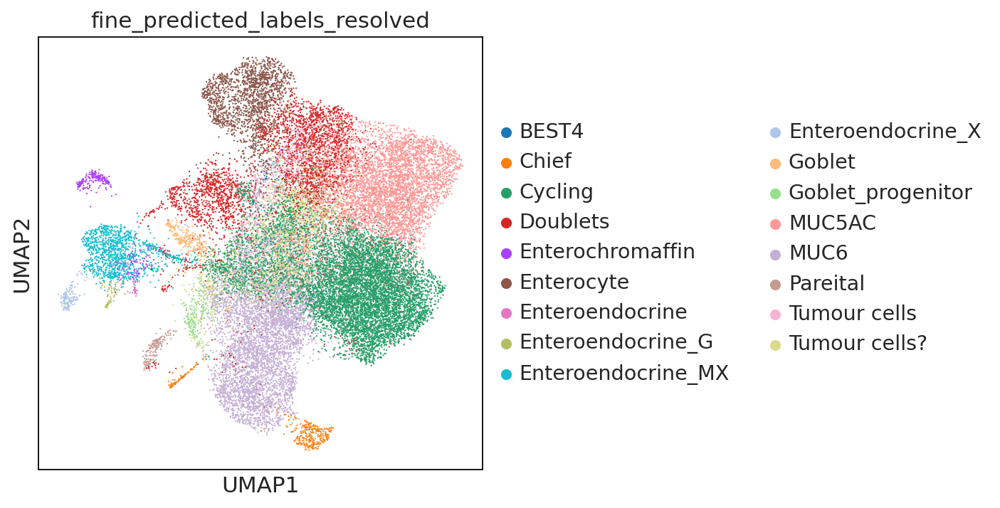

In [83]:
ON = {O:N for O,N in zip(unknown.index,unknown["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

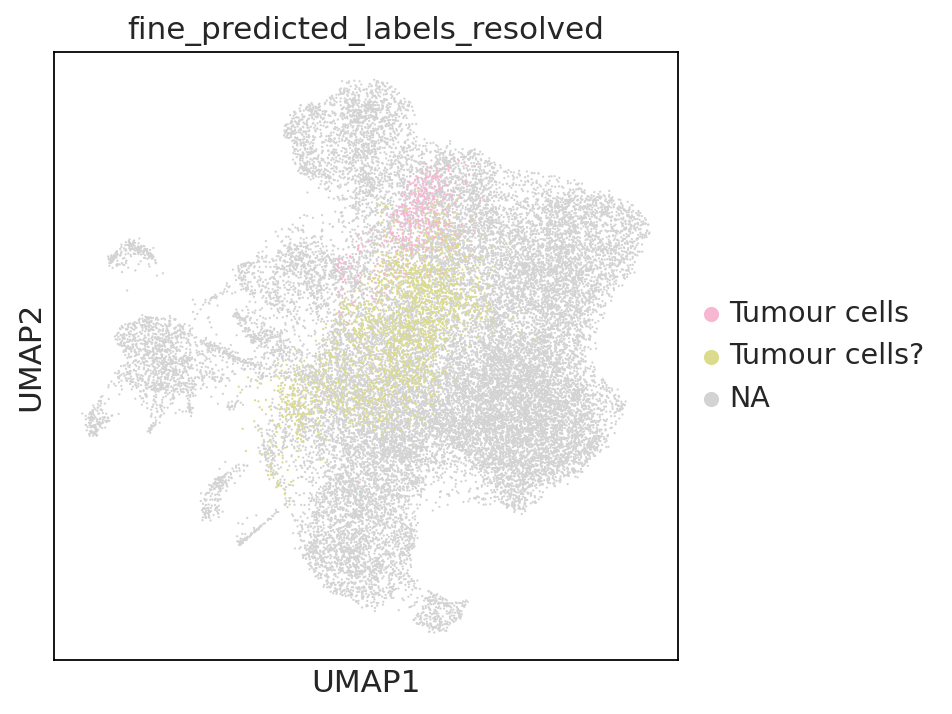

In [84]:
sc.pl.umap(adata,color='fine_predicted_labels_resolved',groups=['Tumour cells','Tumour cells?'])

In [85]:
no_doublets = adata[~adata.obs.fine_predicted_labels_resolved.isin(['Doublets'])].copy()

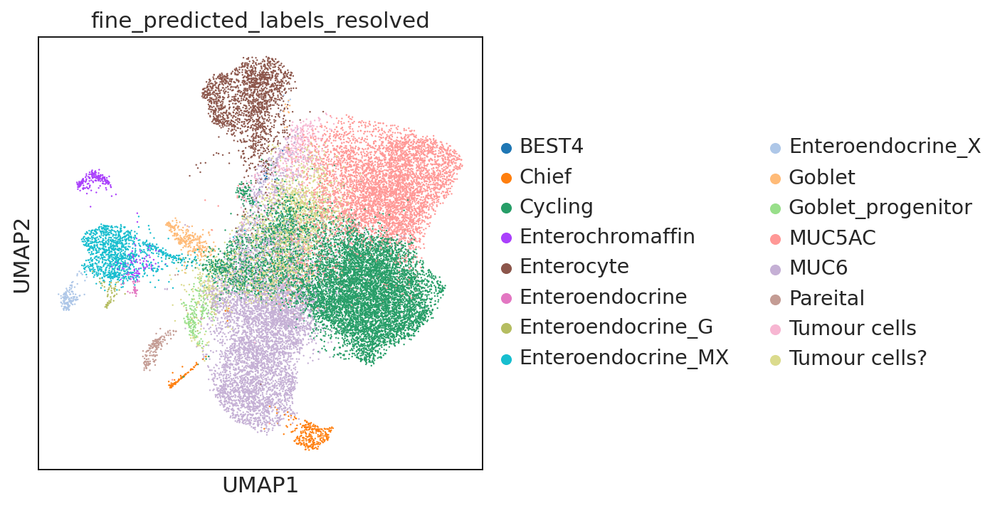

In [86]:
sc.pl.umap(no_doublets,color='fine_predicted_labels_resolved')

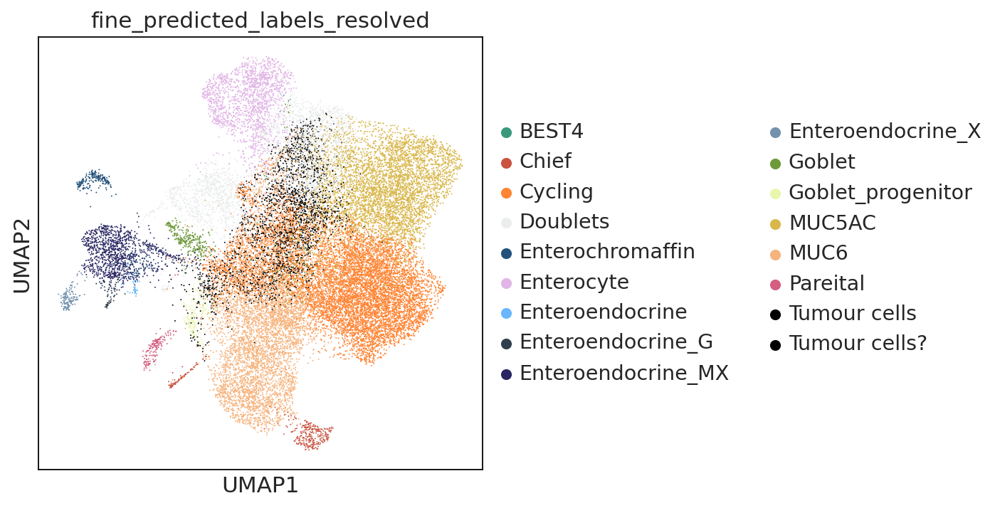

In [87]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#39997c',#BEST4
                                            '#c95340',#chief
                                            '#ff8433',#'Cycling'
                                            '#ebeded',#doublets
                                           '#22517a',#enterochromaffin
                                            '#e1b5e6',#enterocyte
                                           '#68b7fc',#enteroendocrine
                                            '#2f3f4d',#G_enteroendocrine
                                            '#292663',#MX enteroendocrine
                                            '#7292ad',#X_enteroendocrine
                                            '#6c9939',#goblet
                                            '#e9f7ad',#goblet progenitor
                                            '#d9b74a',#MUC5AC
                                            '#f7b37c',#MUC6
                                           '#d45f80',#pareital 
                                                          '#000000',#tumour
                                                                        '#000000'#tumour?
                                               
                                               
    
    
                                              ],size=3)

In [89]:
annot = adata.obs[['fine_predicted_labels_uncertflagged','fine_predicted_labels_resolved']]

In [90]:
annot

,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,
TCAGCTCCACCCATTC-GSM4546305,Enteroendocrine_MX,Enteroendocrine_MX
TCCCGATTCGGCATCG-GSM4546325,Unknown,Enteroendocrine_MX
GCGAGAACACAGGCCT-GSM4546305,Unknown,Doublets
CAGATCACACTATCTT-GSM4546342,MUC5AC,MUC5AC
CACATTTTCCCGGATG-GSM4546335,Unknown,Tumour cells?
...,...,...
GCTCCTAGTCCTCTTG-GSM4546342,Cycling,Cycling
CCCTCCTTCACTTCAT-GSM4546335,Cycling,Cycling
CTTAGGACACAGACAG-GSM4546317,Cycling,Cycling


In [92]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_annot/resolved_annot/epi_stomach_disease_annot.csv')

In [ ]:
#unsure about tumour cell annotation, needs further refinement

In [93]:
adata

AnnData object with n_obs × n_vars = 29381 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

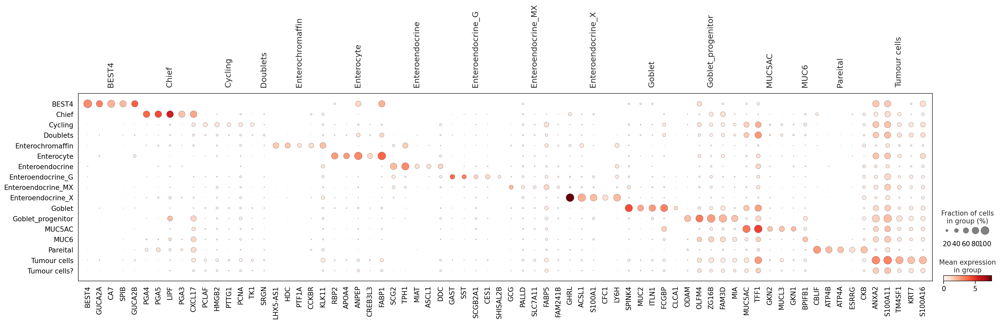

In [94]:
mkst = calc_marker_stats(adata, groupby="fine_predicted_labels_resolved")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='fine_predicted_labels_resolved', mks=mks)

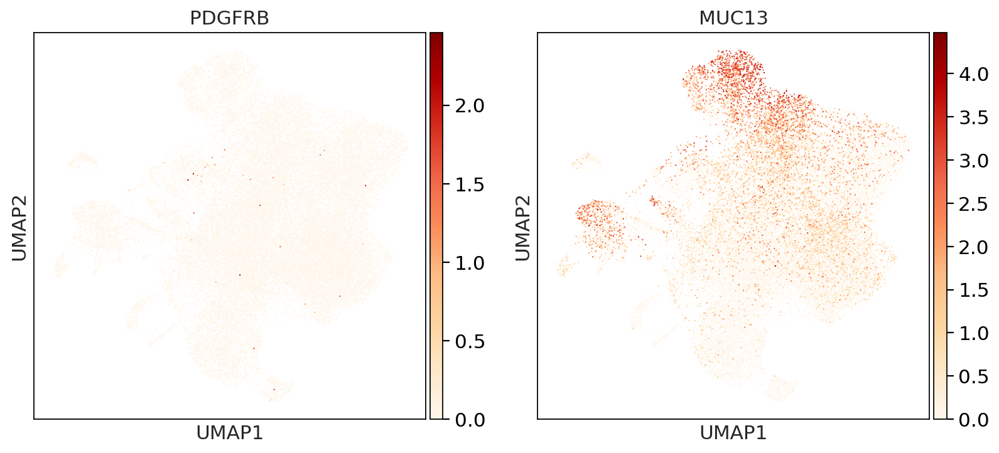

In [97]:
sc.pl.umap(adata,color=['PDGFRB','MUC13'],cmap='OrRd')

In [98]:
adata

AnnData object with n_obs × n_vars = 29381 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

#### Tried to identify cancer cells from original study but no cell annotations available

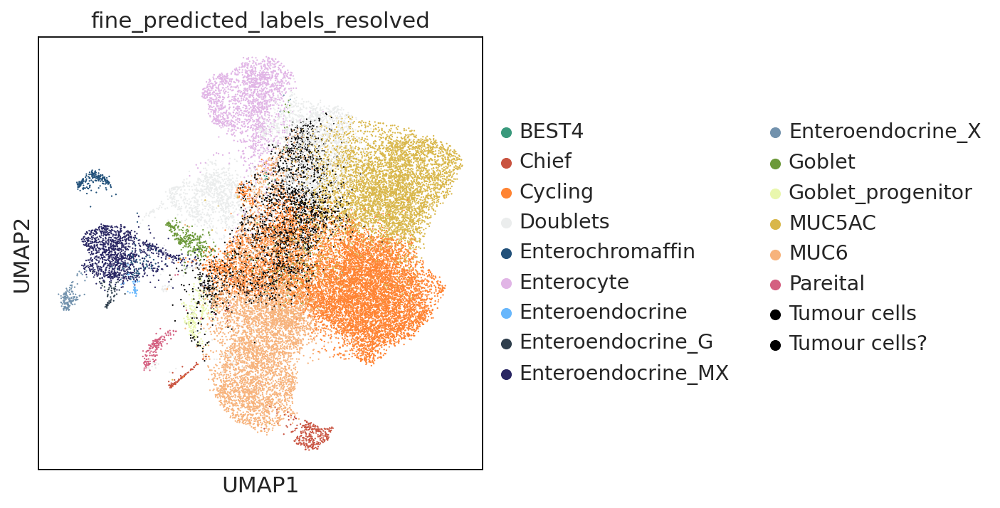

In [108]:
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

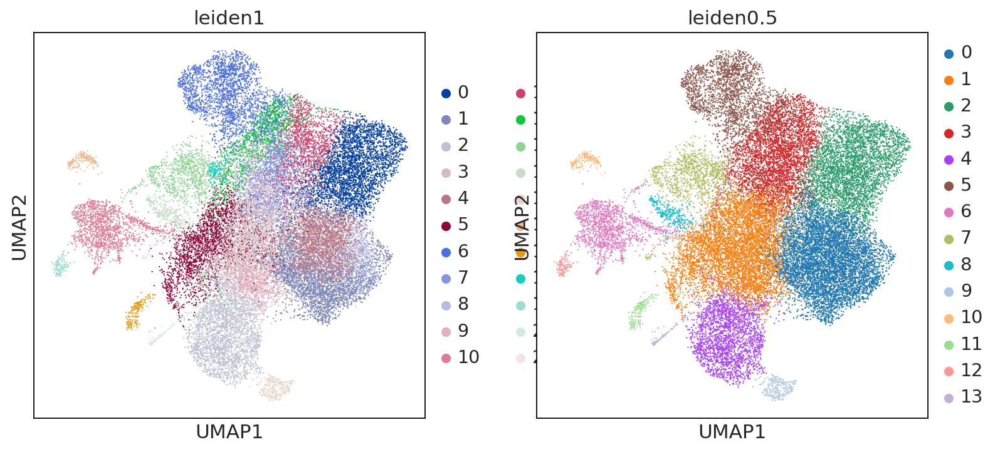

In [117]:
sc.pl.umap(adata,color=['leiden1','leiden0.5'])

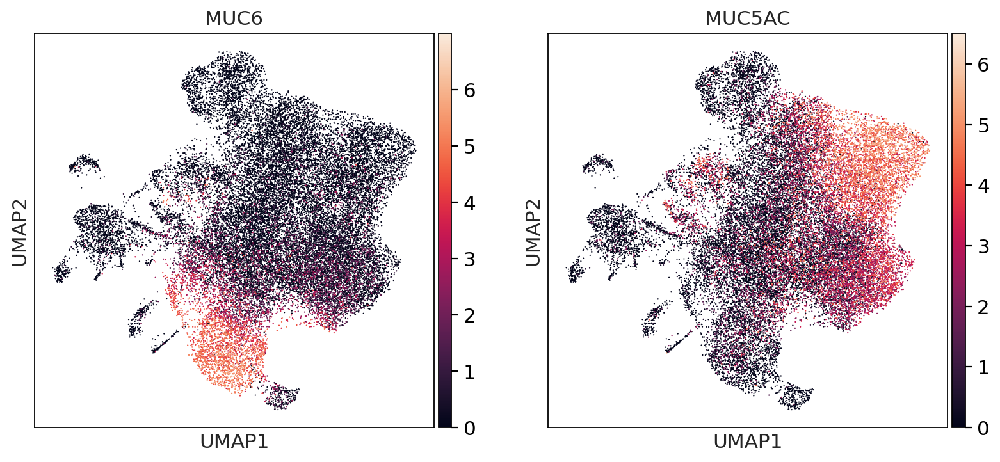

In [112]:
sc.pl.umap(adata,color=['MUC6','MUC5AC'])

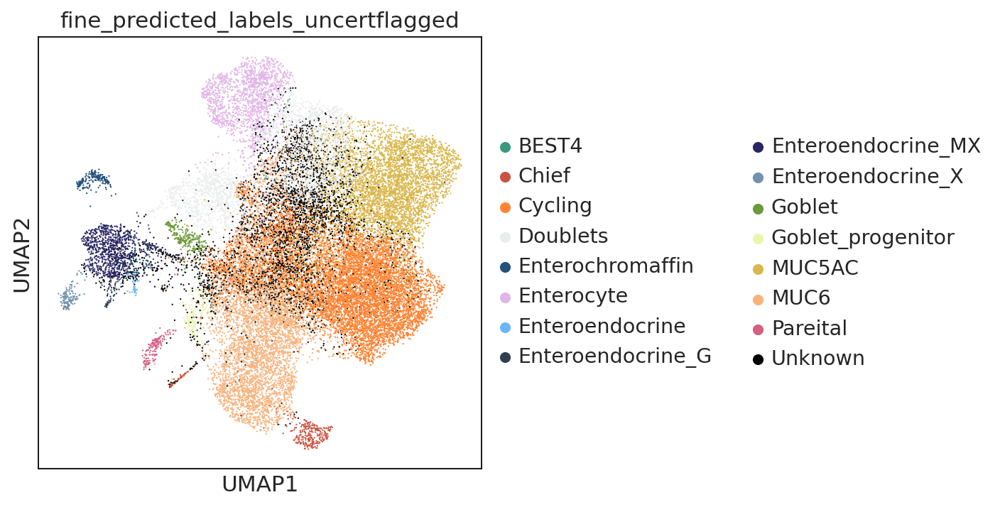

In [114]:
sc.pl.umap(adata,color=['fine_predicted_labels_uncertflagged'])

In [109]:
adata.obs['fine_predicted_labels_resolved_tumour'] = adata.obs['fine_predicted_labels_resolved']

In [110]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Chief,Cycling,Doublets,Enterochromaffin,Enterocyte,Enteroendocrine,Enteroendocrine_G,Enteroendocrine_MX,Enteroendocrine_X,Goblet,Goblet_progenitor,MUC5AC,MUC6,Pareital,Unknown
leiden1,,,,,,,,,,,,,,,,
0,0,0,15,4,0,0,0,0,0,0,0,0,3257,59,0,78
1,0,0,2462,22,0,0,0,0,0,0,0,0,89,22,0,151
2,0,12,0,18,0,1,0,0,0,0,0,0,11,2526,0,31
3,0,8,715,203,0,13,0,0,1,0,0,0,255,529,14,762
4,0,0,2220,15,0,0,0,0,0,0,0,0,0,0,0,44
5,0,0,742,9,0,22,0,2,4,0,0,197,0,768,0,482
6,0,0,8,481,0,1614,0,0,0,3,0,0,1,0,0,81
7,0,0,474,507,0,20,0,0,0,0,0,0,248,80,0,686
8,0,0,1288,9,0,0,0,0,0,0,0,0,158,14,0,153


In [116]:
pd.crosstab(adata.obs['leiden0.5'],adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Chief,Cycling,Doublets,Enterochromaffin,Enterocyte,Enteroendocrine,Enteroendocrine_G,Enteroendocrine_MX,Enteroendocrine_X,Goblet,Goblet_progenitor,MUC5AC,MUC6,Pareital,Unknown
leiden0.5,,,,,,,,,,,,,,,,
0,0,0,6097,54,0,0,0,0,0,0,0,0,141,10,0,294
1,0,8,1635,92,0,13,0,2,4,0,0,197,228,2520,10,1489
2,0,0,73,46,0,0,0,0,0,0,0,0,3817,64,0,225
3,7,0,322,1303,0,16,0,0,0,0,0,0,594,307,1,1213
4,0,14,2,37,0,1,0,0,0,0,0,0,1,2459,0,30
5,1,0,19,497,0,1645,0,0,0,4,3,0,6,1,0,128
6,0,0,11,57,88,0,33,58,925,6,2,0,0,1,3,220
7,0,1,95,932,0,13,0,0,0,0,0,0,13,25,0,133
8,0,0,14,10,0,0,0,0,0,0,245,0,1,1,0,35


In [118]:
unknown['fine_predicted_labels_resolved'] = (unknown['leiden1']
        .map(lambda x:{'0':'MUC5AC',
                       '1':'Cycling',
                       '2':'MUC6',
                       '3':'Cycling', #mixture of many
                       '4':'Cycling',
                       '5':'MUC6', 
                       '6':'Enterocyte',
                       '7':'Doublets',
                       '8':'Cycling', 
                       '9':'MUC6',
                       '10':'Enteroendocrine_MX',
                       '11':'MUC5AC', #these could potentially be cancer cells
                       '12':'MUC6', 
                       '13':'Doublets',
                       '14':'Goblet',
                       '15':'Chief',
                       '16':'Enterochromaffin',
                       '17':'Pareital',
                       '18':'Cycling', 
                       '19':'Enteroendocrine_X',
                       '20':'Chief',
                       '21':'Doublets'
                         }.get(x,x)).astype('category'))

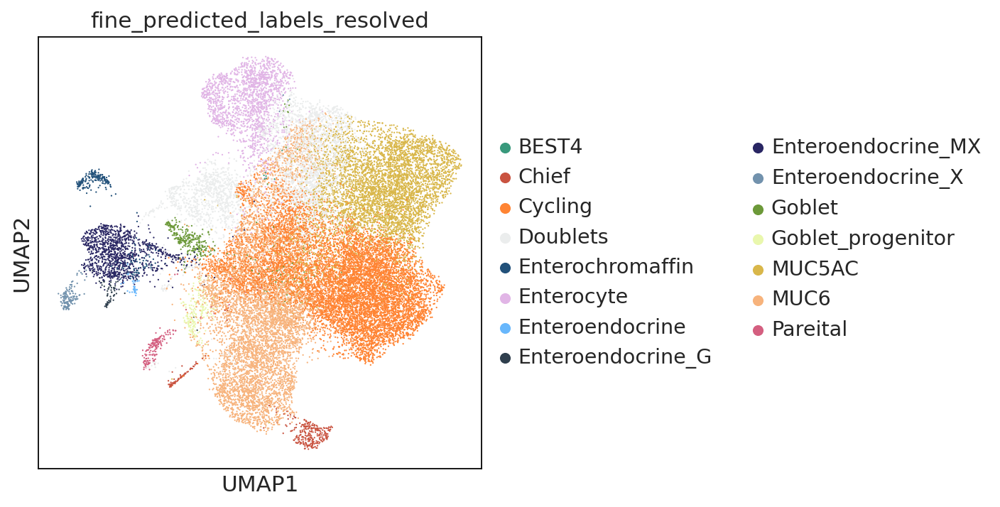

In [120]:
ON = {O:N for O,N in zip(unknown.index,unknown["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

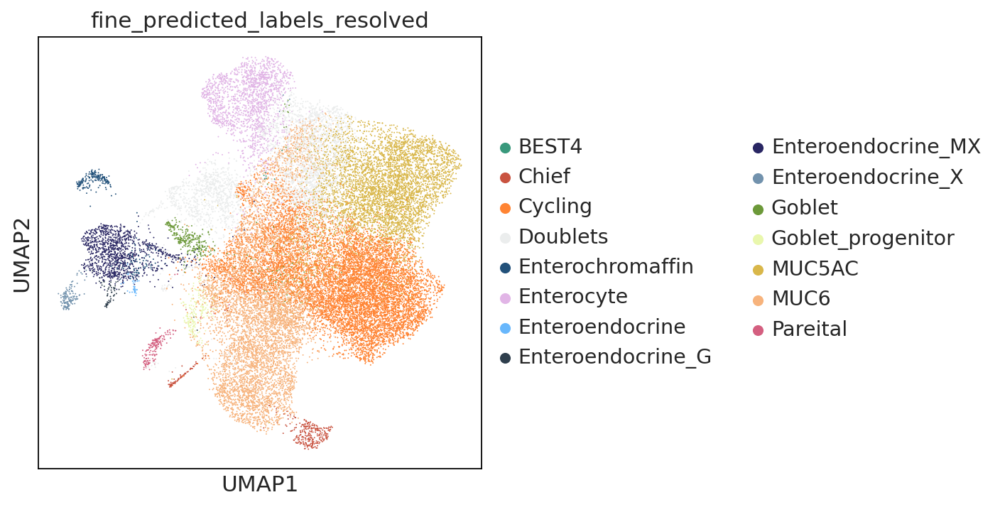

In [121]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#39997c',#BEST4
                                            '#c95340',#chief
                                            '#ff8433',#'Cycling'
                                            '#ebeded',#doublets
                                           '#22517a',#enterochromaffin
                                            '#e1b5e6',#enterocyte
                                           '#68b7fc',#enteroendocrine
                                            '#2f3f4d',#G_enteroendocrine
                                            '#292663',#MX enteroendocrine
                                            '#7292ad',#X_enteroendocrine
                                            '#6c9939',#goblet
                                            '#e9f7ad',#goblet progenitor
                                            '#d9b74a',#MUC5AC
                                            '#f7b37c',#MUC6
                                           '#d45f80',#pareital 
                                               
                                               
    
    
                                              ],size=3)

In [122]:
no_doublets = adata[~adata.obs.fine_predicted_labels_resolved.isin(['Doublets'])].copy()

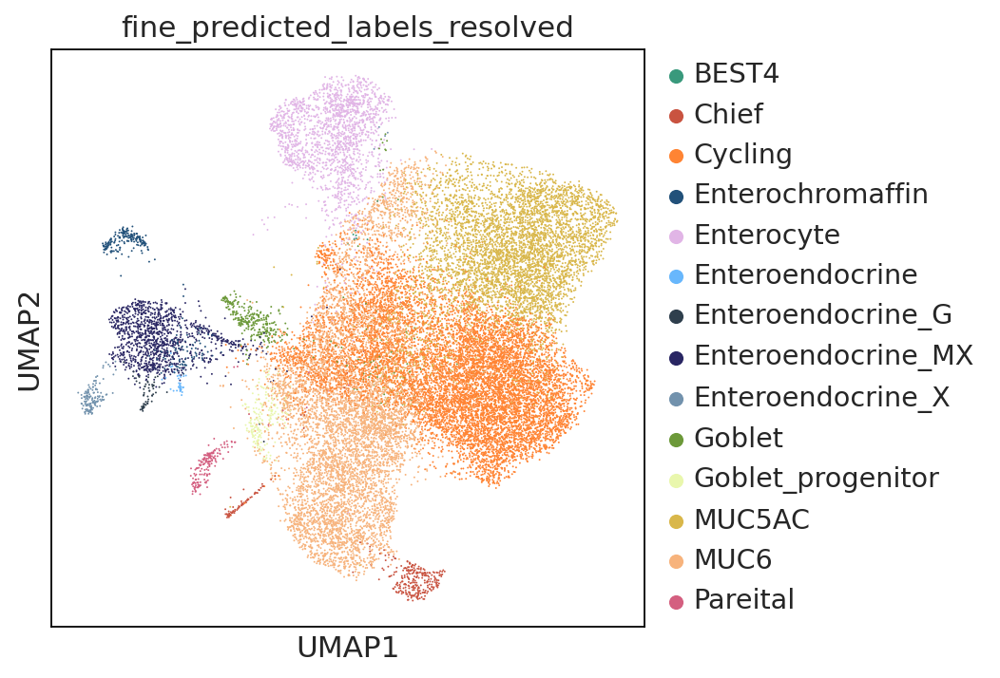

In [123]:
sc.pl.umap(no_doublets,color='fine_predicted_labels_resolved',palette = ['#39997c',#BEST4
                                            '#c95340',#chief
                                            '#ff8433',#'Cycling'
                                            #'#ebeded',#doublets
                                           '#22517a',#enterochromaffin
                                            '#e1b5e6',#enterocyte
                                           '#68b7fc',#enteroendocrine
                                            '#2f3f4d',#G_enteroendocrine
                                            '#292663',#MX enteroendocrine
                                            '#7292ad',#X_enteroendocrine
                                            '#6c9939',#goblet
                                            '#e9f7ad',#goblet progenitor
                                            '#d9b74a',#MUC5AC
                                            '#f7b37c',#MUC6
                                           '#d45f80',#pareital 
                                               
                                               
    
    
                                              ],size=3)

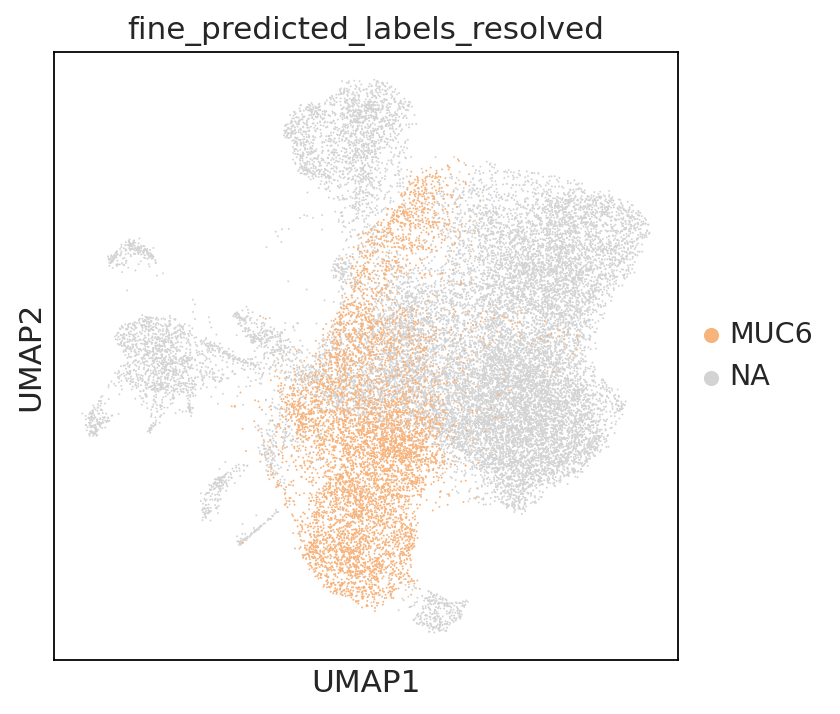

In [125]:
sc.pl.umap(no_doublets,color='fine_predicted_labels_resolved',groups='MUC6',size=3)

In [126]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Chief,Cycling,Doublets,Enterochromaffin,Enterocyte,Enteroendocrine,Enteroendocrine_G,Enteroendocrine_MX,Enteroendocrine_X,Goblet,Goblet_progenitor,MUC5AC,MUC6,Pareital,Unknown
leiden1,,,,,,,,,,,,,,,,
0,0,0,15,4,0,0,0,0,0,0,0,0,3257,59,0,78
1,0,0,2462,22,0,0,0,0,0,0,0,0,89,22,0,151
2,0,12,0,18,0,1,0,0,0,0,0,0,11,2526,0,31
3,0,8,715,203,0,13,0,0,1,0,0,0,255,529,14,762
4,0,0,2220,15,0,0,0,0,0,0,0,0,0,0,0,44
5,0,0,742,9,0,22,0,2,4,0,0,197,0,768,0,482
6,0,0,8,481,0,1614,0,0,0,3,0,0,1,0,0,81
7,0,0,474,507,0,20,0,0,0,0,0,0,248,80,0,686
8,0,0,1288,9,0,0,0,0,0,0,0,0,158,14,0,153


In [127]:
adata.obs['fine_predicted_labels_resolved_v2'] = adata.obs['fine_predicted_labels_resolved']

In [128]:
unknown['fine_predicted_labels_resolved_unknown'] = (unknown['leiden1']
        .map(lambda x:{'0':'MUC5AC',
                       '1':'Cycling',
                       '2':'MUC6',
                       '3':'Unknown', #mixture of many
                       '4':'Cycling',
                       '5':'MUC6', 
                       '6':'Enterocyte',
                       '7':'Unknown',
                       '8':'Cycling', 
                       '9':'MUC6',
                       '10':'Enteroendocrine_MX',
                       '11':'MUC5AC', #these could potentially be cancer cells
                       '12':'Unknown', 
                       '13':'Doublets',
                       '14':'Goblet',
                       '15':'Chief',
                       '16':'Enterochromaffin',
                       '17':'Pareital',
                       '18':'Cycling', 
                       '19':'Enteroendocrine_X',
                       '20':'Chief',
                       '21':'Doublets'
                         }.get(x,x)).astype('category'))

In [131]:
unknown

,leiden1,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved,fine_predicted_labels_resolved_unknown
index,,,,
AAACCTGGTTCCACGG-GSM5101014,3,Unknown,Cycling,Unknown
AAACCTGTCCCTAACC-GSM5101014,9,Unknown,MUC6,MUC6
AAACGGGAGAGTACCG-GSM5101014,13,Unknown,Doublets,Doublets
AAAGATGGTTCAGTAC-GSM5101014,12,Unknown,MUC6,Unknown
AAAGCAAGTTATGCGT-GSM5101014,11,Unknown,MUC5AC,MUC5AC
...,...,...,...,...
TGCACCTTCTGTCCGT-GSM4546346,8,Unknown,Cycling,Cycling
TGCCCTATCGTAGATC-GSM4546346,1,Unknown,Cycling,Cycling
TGCGGGTCAACACCCG-GSM4546346,12,Unknown,MUC6,Unknown


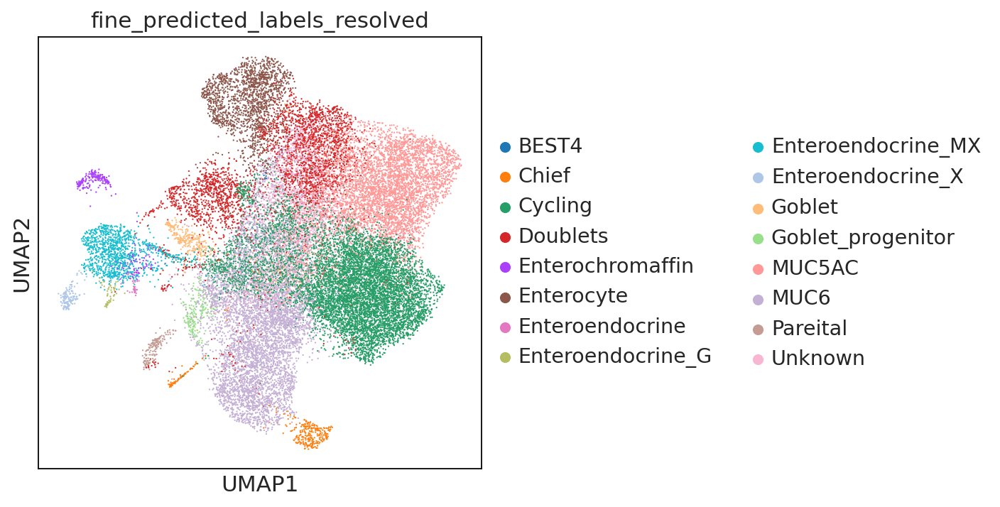

In [132]:
ON = {O:N for O,N in zip(unknown.index,unknown["fine_predicted_labels_resolved_unknown"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

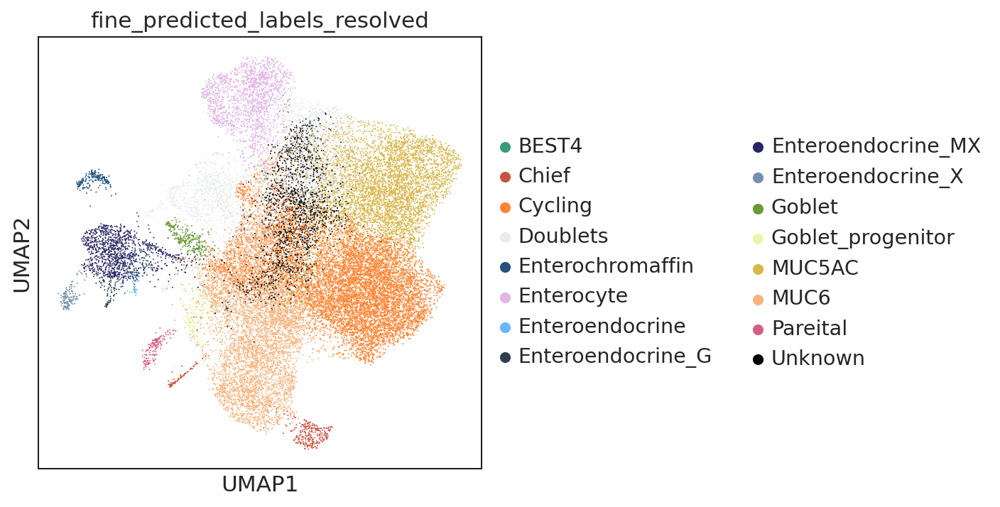

In [135]:
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#39997c',#BEST4
                                            '#c95340',#chief
                                            '#ff8433',#'Cycling'
                                            '#ebeded',#doublets
                                           '#22517a',#enterochromaffin
                                            '#e1b5e6',#enterocyte
                                           '#68b7fc',#enteroendocrine
                                            '#2f3f4d',#G_enteroendocrine
                                            '#292663',#MX enteroendocrine
                                            '#7292ad',#X_enteroendocrine
                                            '#6c9939',#goblet
                                            '#e9f7ad',#goblet progenitor
                                            '#d9b74a',#MUC5AC
                                            '#f7b37c',#MUC6
                                           '#d45f80',#pareital 
                                            '#000000',#unknown
                                               
                                               
    
    
                                              ],size=3)

In [136]:
annot = adata.obs[['fine_predicted_labels_uncertflagged','fine_predicted_labels_resolved']]

In [137]:
#export final annotations
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_annot/resolved_annot/epi_stomach_disease_annot.csv')

In [1]:
#plotting tumour markers for revision comment 2.11

In [2]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/disease/compartments/Epi.pooled_disease.gene_cellbender.good_qc_cluster_mito80.stringent_doublet_removed.hvg7500_noCC.scvi_output.lv20_batch256.with_raw_counts.20230124.h5ad')

In [4]:
adata = adata[adata.obs.organ_unified.isin(['stomach'])].copy()
adata_scanvi = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/X_scANVI/disease/disease_fine_annot_predict_Epi_stomach_method2_20230226.csv.gz',compression='gzip',index_col=0)
adata.obsm['X_scANVI'] = adata_scanvi
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

In [6]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [7]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]

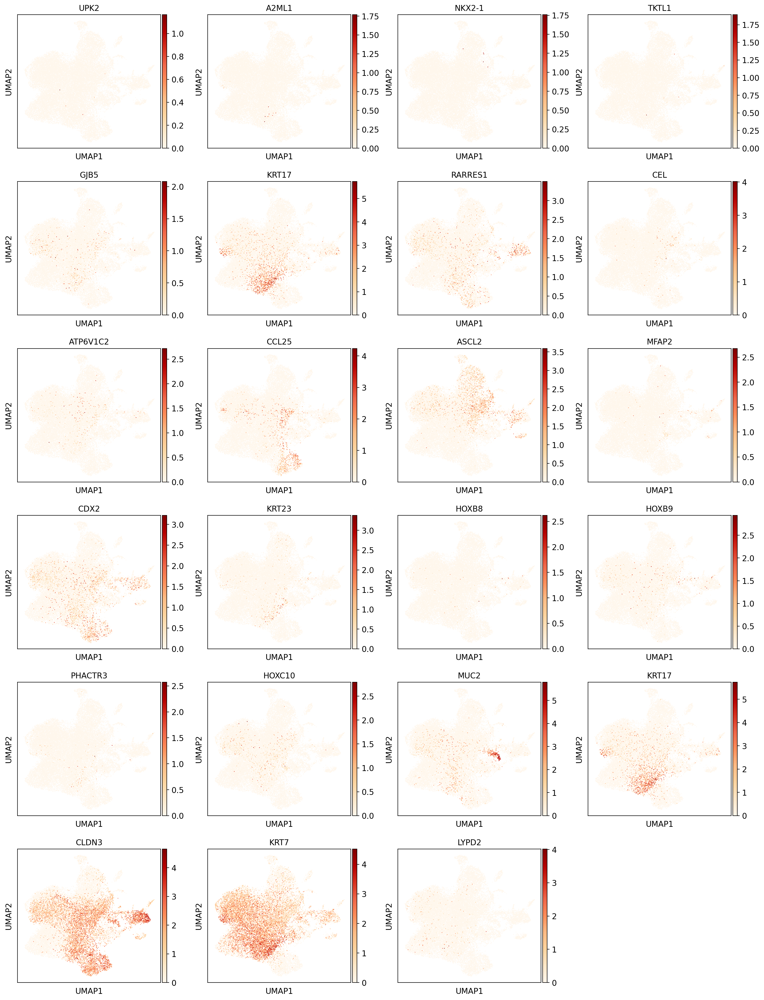

In [26]:
#https://www.nature.com/articles/s41467-022-32627-z/figures/2
#plot some cancer markers from this study
sc.pl.umap(adata,color= ['UPK2','A2ML1','NKX2-1','TKTL1','GJB5','KRT17','RARRES1',
                                 'CEL','ATP6V1C2','CCL25','ASCL2','MFAP2','CDX2','KRT23','HOXB8','HOXB9','PHACTR3',
                                 'HOXC10','MUC2','KRT17','CLDN3','KRT7','LYPD2'],cmap='OrRd',save='tumour_markers_umaprebuttalfigure2-11.pdf')

In [12]:
annot = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_annot/resolved_annot/epi_stomach_disease_annot.csv',index_col=0)

In [13]:
annot

,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,
TCAGCTCCACCCATTC-GSM4546305,Enteroendocrine_MX,Enteroendocrine_MX
TCCCGATTCGGCATCG-GSM4546325,Unknown,Enteroendocrine_MX
GCGAGAACACAGGCCT-GSM4546305,Unknown,Doublets
CAGATCACACTATCTT-GSM4546342,MUC5AC,MUC5AC
CACATTTTCCCGGATG-GSM4546335,Unknown,Unknown
...,...,...
GCTCCTAGTCCTCTTG-GSM4546342,Cycling,Cycling
CCCTCCTTCACTTCAT-GSM4546335,Cycling,Cycling
CTTAGGACACAGACAG-GSM4546317,Cycling,Cycling


In [14]:
adata.obs['level_3_annot'] = annot.fine_predicted_labels_resolved

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


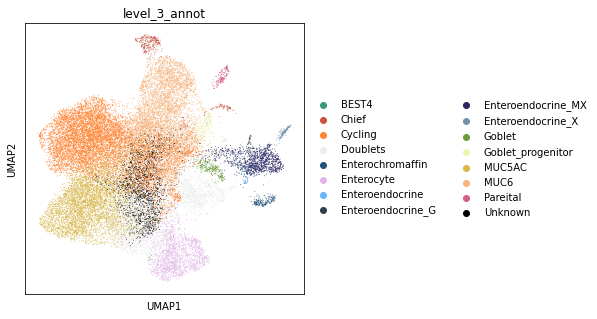

In [16]:
sc.pl.umap(adata,color='level_3_annot',palette = ['#39997c',#BEST4
                                            '#c95340',#chief
                                            '#ff8433',#'Cycling'
                                            '#ebeded',#doublets
                                           '#22517a',#enterochromaffin
                                            '#e1b5e6',#enterocyte
                                           '#68b7fc',#enteroendocrine
                                            '#2f3f4d',#G_enteroendocrine
                                            '#292663',#MX enteroendocrine
                                            '#7292ad',#X_enteroendocrine
                                            '#6c9939',#goblet
                                            '#e9f7ad',#goblet progenitor
                                            '#d9b74a',#MUC5AC
                                            '#f7b37c',#MUC6
                                           '#d45f80',#pareital 
                                            '#000000',#unknown
                                               
                                               
    
    
                                              ],size=3)

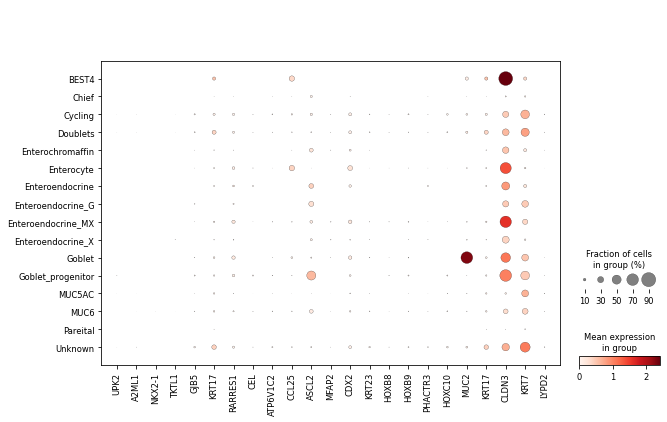

In [18]:
#https://www.nature.com/articles/s41467-022-32627-z/figures/2
#plot some cancer markers from this study
sc.pl.dotplot(adata,var_names = ['UPK2','A2ML1','NKX2-1','TKTL1','GJB5','KRT17','RARRES1',
                                 'CEL','ATP6V1C2','CCL25','ASCL2','MFAP2','CDX2','KRT23','HOXB8','HOXB9','PHACTR3',
                                 'HOXC10','MUC2','KRT17','CLDN3','KRT7','LYPD2'],groupby='level_3_annot',save='_tumour_markers_rebuttalfigure2-11.pdf')